<a href="https://colab.research.google.com/github/catarina-moreira/causabilityXAi/blob/master/Diabetes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Demystifying Predictive Black-Box Models: An Interpretable Probabilistic Approach

Catarina Moreira, Yu-Liang Chou, Mythreyi Velmurugan, Renuka Sindhgatta Rajan, Chun Ouyang, Peter Bruza

**Abstract** 


## Setting Up

### Connecting to Google Drive

In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [2]:
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

# login into my google drive account
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

# main functions are in this file
learning_lib = drive.CreateFile( {'id' : '1wwSN3AIl_dmayKENu5jnc1BRaNPe8BZc'}).GetContentFile("learning.py")


### Installing Required Libraries

In [ ]:
# Install tensorflow
try:
    # tensorflow_version only exists in Colab
    %tensorflow_version 2.2.0
except Exception:
    pass

In [ ]:
# install required libraries
!pip install pyagrum
!pip install lime
!pip install shap


### Importing Libraries

In [5]:
from IPython.core.display import HTML
import numpy as np
import pandas as pd
import random as rn
import time

# current explanable algorithms
import lime
import shap
from lime import lime_tabular

# import auxiliary functions
from learning import *

%matplotlib inline

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

## Diabetes Dataset

**Context**
This dataset is originally from the National Institute of Diabetes and Digestive and Kidney Diseases. The objective of the dataset is to diagnostically predict whether or not a patient has diabetes, based on certain diagnostic measurements included in the dataset. Several constraints were placed on the selection of these instances from a larger database. In particular, all patients here are females at least 21 years old of Pima Indian heritage.

**Content**
The datasets consists of several medical predictor variables and one target variable, Outcome. Predictor variables includes the 
- number of pregnancies the patient has had, 
- their BMI, 
- insulin level, 
- age,
- glucose,
- blood pressure,
- skin thickness,
- Diabetes pedigree function


### Loading Black Box

In [6]:
# path to project folder
PATH = "/content/drive/My Drive/Colab Notebooks/DDS/"

#### Setting up data

In [7]:
# name of dataset
DATASET_NAME = "diabetes.csv"

# variable containing the class labels in this case the dataset contains:
# 0 - if not diabetes
# 1 - if diabetes
class_var = "Outcome"

# load dataset
dataset_path = PATH + "datasets/" + DATASET_NAME
data = pd.read_csv( dataset_path )

# features
feature_names = data.drop([class_var], axis=1).columns.to_list()
print("Features")
print(feature_names)

# balance dataset
sampled_data = data.sample(frac=1)
sampled_data = sampled_data[ sampled_data["Outcome"] == 0]

no_data = sampled_data.sample(frac=1)[0:268]
yes_data = data[ data["Outcome"] == 1]

balanced_data = [no_data,yes_data]
balanced_data = pd.concat(balanced_data)

Features
['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI', 'DiabetesPedigreeFunction', 'Age']


#### Load Trained Model

In [8]:
# apply one hot encoder to data
# standardize the input between 0 and 1
X, Y, encoder, scaler = encode_data( balanced_data, class_var)

n_features = X.shape[1]
n_classes = len(data[class_var].unique())

# load existing training data
print("Loading training data...")
X_train, Y_train, X_test, Y_test, X_validation, Y_validation= load_training_data( dataset_path )

# the best performing model was obtained with 5 hidden layers with 12 neurons each
model_name = "model_h5_N12"

# specify paths where the blackbox model was saved
path_serialisation_model = PATH + "training/" + DATASET_NAME.replace(".csv", "") + "/model/" 
path_serialisation_histr = PATH + "training/" + DATASET_NAME.replace(".csv", "") + "/history/" 

# load model and model performance history
print("Loading Blackbox model...")
model_history = load_model_history( model_name, path_serialisation_histr )
model = load_model( model_name, path_serialisation_model )

# check model
model.summary()

Loading training data...
Loading Blackbox model...
Loaded model from disk
Model: "model_h5_N12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_293 (Dense)            (None, 12)                108       
_________________________________________________________________
dense_294 (Dense)            (None, 12)                156       
_________________________________________________________________
dense_295 (Dense)            (None, 12)                156       
_________________________________________________________________
dense_296 (Dense)            (None, 12)                156       
_________________________________________________________________
dense_297 (Dense)            (None, 12)                156       
_________________________________________________________________
dense_298 (Dense)            (None, 12)                156       
______________________________________________

#### Evaluate Model

In [9]:
# evaluate loaded model on test and training data
optim = keras.optimizers.Nadam(lr=0.0001, beta_1=0.9, beta_2=0.999)
model.compile(loss='categorical_crossentropy', optimizer=optim, metrics=['accuracy'])

train_loss, train_acc = model.evaluate(X_train, Y_train, verbose=1)
test_loss, test_acc = model.evaluate(X_test, Y_test, verbose=1)

print('\n[Accuracy] Train: %.3f, Test: %.3f' % (train_acc, test_acc))
print('[Loss] Train: %.3f, Test: %.3f' % (train_loss, test_loss))

3/3 [==============================] - 0s 4ms/step - loss: 0.5311 - accuracy: 0.7375

[Accuracy] Train: 0.759, Test: 0.738
[Loss] Train: 0.496, Test: 0.531


### Searching for specific datapoints for local evaluation

In [10]:
# creates a dictionary with the following information:
# ground_truth
# index
# original_vector
# scaled_vector
# prediction_type
local_data_dict = generate_local_predictions( X_test, Y_test, model, scaler, encoder )

# separates vectors into true positives, true negatives
# false positives and false negatives
true_positives,true_negatives, false_positives, false_negatives = wrap_information( local_data_dict )

# add class variable to the feature list
feature_names.append("Diabetes?")

In [11]:
# Example of a True Positve Instance
true_positives[0]

{'ground_truth': 1,
 'index': 0,
 'original_vector': [1.0,
  189.0,
  56.065574,
  23.0,
  846.0,
  30.1,
  0.400598,
  65.705882],
 'prediction_type': 'TRUE POSITIVE',
 'predictions': 1,
 'scaled_vector': [0.05882352941176471,
  0.9497487437185927,
  0.4918032786885247,
  0.23232323232323235,
  1.0,
  0.4485842026825633,
  0.13404710920770876,
  0.7450980392156861]}

## Generating Explanations with Bayesian Networks

In [12]:
label_lst = ["No", "Yes"]
class_var = "Diabetes?"

VAR = 0.1

feature_names_cp = feature_names.copy()
feature_names_cp.append("Diabetes?")
feature_names.remove('Diabetes?')

In [13]:
feature_names_cp

['Pregnancies',
 'Glucose',
 'BloodPressure',
 'SkinThickness',
 'Insulin',
 'BMI',
 'DiabetesPedigreeFunction',
 'Age',
 'Diabetes?',
 'Diabetes?']

### Examples for Users

#### Example of Explanation for a Single True Positive

In [14]:
instance = true_positives[0]

[bn, inference, infoBN, markov_blanket] = generate_BN_explanationsMB(instance, label_lst, feature_names, class_var, 
                                                                       encoder, scaler, model, PATH, DATASET_NAME, variance = VAR)
inference = gnb.getInference(bn, evs={ 'Diabetes?' : 'Yes' },targets=feature_names_cp )
gnb.sideBySide(*[inference, markov_blanket, infoBN ], captions=[ "Inference", "Markov Blanket", "Information BN" ])

Selecting Greedy Hill Climbing Algorithm


no_name <!-- 0 --> 0 Pregnancies <!-- 8 --> 8 Diabetes? <!-- 0->8 --> 0->8 <!-- 2 --> 2 BloodPressure <!-- 2->8 --> 2->8


##### Report

In [15]:
# Patient's original features
for indx in range(0, len(feature_names)):
  print(feature_names[indx] + ":\t" + str(true_positives[0]['original_vector'][indx]))
  

Pregnancies:	1.0
Glucose:	189.0
BloodPressure:	56.065574
SkinThickness:	23.0
Insulin:	846.0
BMI:	30.1
DiabetesPedigreeFunction:	0.400598
Age:	65.705882


In [18]:
rep = HTML("<h3>REPORT</h3>" + 
      "<p>Knowing about the patient's <span style='color:red'>Glucose</span> levels makes <span style='color:red'>SkinThickness</span>, <span style='color:red'>Insulin</span>, " +
      "<span style='color:red'>BMI</span>, <span style='color:red'>Age</span> and <span style='color:red'>DiabetesPedigreeFunction</span><br>"+
      "NOT RELEVANT to assess <span style='color:red'>Diabetes</span>.</p>"+
      "<p>The features CONTRIBUTING for <span style='color:red'>Diabetes</span> are <span style='color:red'>BloodPressure</span>" +
     " and <span style='color:red'>Pregnancies</span>.</p>"+
     "<p><b>Recommendation:</b> Given the confidence of the explanation (100%), the model is <span style='color:red'><b>certain that the patient has Diabetes</b></span></p>")



In [19]:
inf1 = gnb.getInference(bn, evs={ 'Glucose' : '"(179.00000, 198.6000]"',
                                  'Diabetes?' : 'Yes'},targets=feature_names_cp)

a = gnb.sideBySide(*[inf1, rep], captions=[ "Interpretation", "Explanation Report" ])

##### Comparison with LIME

Time taken to create explainer: 0.02 seconds


Time taken to provide explanation 0.58 seconds


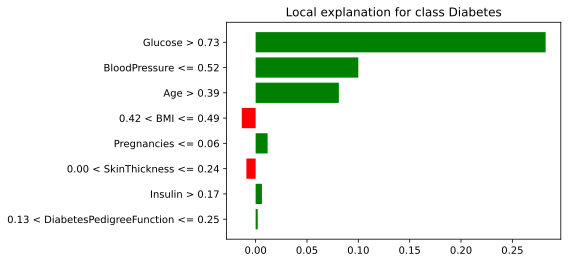

In [20]:
MAX_FEAT = 8

start_time = time.time()

# LIME has one explainer for all the models
explainer = lime_tabular.LimeTabularExplainer(X_train, feature_names= feature_names, 
                                                  class_names=["No Diabetes", "Diabetes"], verbose=False, mode='classification')

elapsed = time.time() - start_time

print ("Time taken to create explainer:", round(elapsed, 2), "seconds")

start_time = time.time()
# explain instance
patients_feat = np.array(instance['scaled_vector'])
exp = explainer.explain_instance(patients_feat, model.predict, num_features = MAX_FEAT)

# Show the predictions
exp.show_in_notebook(show_table=True)

elapsed = time.time() - start_time
print("Time taken to provide explanation", round (elapsed, 2), "seconds")

#Save the explanation
explanation_plot = exp.as_pyplot_figure()
#plt.tight_layout()
plt.show()

##### Comparison with SHAP

Using 374 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


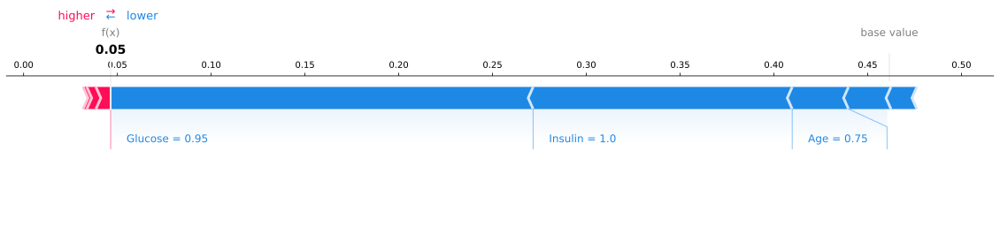

In [101]:
import shap

#Convert to dataframe
X_train_df = pd.DataFrame(data = X_train, columns = feature_names)

# load JS visualization code to notebook
shap.initjs()
shap_explainer = shap.KernelExplainer(model.predict, X_train_df)

instance_df = pd.DataFrame(data = [instance['scaled_vector']], columns = feature_names)

shap_values = shap_explainer.shap_values(instance_df)
exp = shap.force_plot(shap_explainer.expected_value[0], shap_values[0], np.around(instance_df, decimals=2), matplotlib = True, show = False)


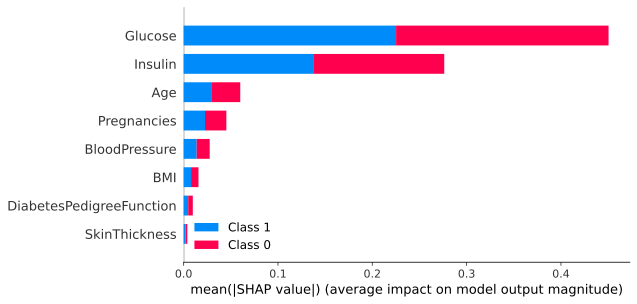

In [102]:
shap.initjs()
shap.summary_plot(shap_values, np.around(instance_df, decimals=2), feature_names=feature_names, max_display=8)

#### Example of Explanation for a Single False Positive

In [103]:
instance = false_positives[6]

[bn, inference, infoBN, markov_blanket] = generate_BN_explanationsMB(instance, label_lst, feature_names, class_var, 
                                                                       encoder, scaler, model, PATH, DATASET_NAME, variance = 0.25)
gnb.sideBySide(*[inference, markov_blanket, infoBN ], captions=[ "Inference", "Markov Blanket", "Information BN" ])

Selecting Greedy Hill Climbing Algorithm


no_name <!-- 8 --> 8 Diabetes?


##### Report

In [ ]:
HTML("<h3>REPORT</h3>" + 
      "<p>Knowing about the patient's <span style='color:red'>Glucose</span> levels makes <span style='color:red'>SkinThickness</span>, <span style='color:red'>Insulin</span>, " +
      "<span style='color:red'>BMI</span>, <span style='color:red'>Age</span> and <span style='color:red'>DiabetesPedigreeFunction</span> "+
      "NOT RELEVANT to assess <span style='color:red'>Diabetes</span>.</p>"+
      "<p>The features CONTRIBUTING for <span style='color:red'>Diabetes</span> are <span style='color:red'>BloodPressure</span>" +
     " and <span style='color:red'>Pregnancies</span>.</p>"+
     "<p><b>Recommendation:</b> Given the confidence of the explanation (100%), the model is <span style='color:red'><b>certain that the patient has Diabetes</b></span></p>")



##### Comparison with LIME

Time taken to create explainer: 0.01 seconds


Time taken to provide explanation 0.56 seconds


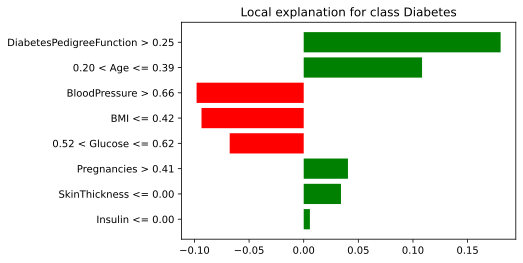

In [104]:
MAX_FEAT = 8

start_time = time.time()

# LIME has one explainer for all the models
explainer = lime_tabular.LimeTabularExplainer(X_train, feature_names= feature_names, 
                                                  class_names=["No Diabetes", "Diabetes"], verbose=False, mode='classification')

elapsed = time.time() - start_time

print ("Time taken to create explainer:", round(elapsed, 2), "seconds")

start_time = time.time()
# explain instance
patients_feat = np.array(instance['scaled_vector'])
exp = explainer.explain_instance(patients_feat, model.predict, num_features = MAX_FEAT)

# Show the predictions
exp.show_in_notebook(show_table=True)

elapsed = time.time() - start_time
print("Time taken to provide explanation", round (elapsed, 2), "seconds")

#Save the explanation
explanation_plot = exp.as_pyplot_figure()
#plt.tight_layout()
plt.show()

##### Comparison with SHAP

Using 374 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


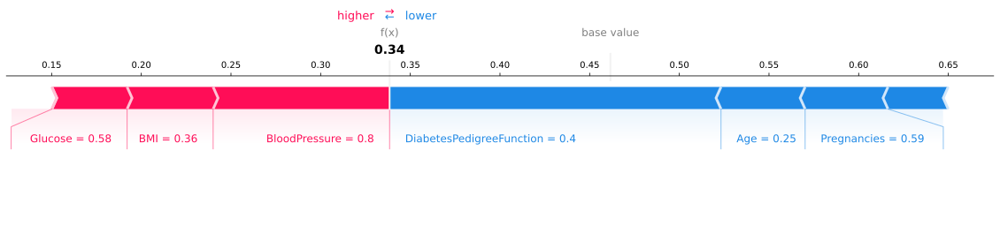

In [105]:

#Convert to dataframe
X_train_df = pd.DataFrame(data = X_train, columns = feature_names)

# load JS visualization code to notebook
shap.initjs()
shap_explainer = shap.KernelExplainer(model.predict, X_train_df)

instance_df = pd.DataFrame(data = [instance['scaled_vector']], columns = feature_names)

shap_values = shap_explainer.shap_values(instance_df)
exp = shap.force_plot(shap_explainer.expected_value[0], shap_values[0], np.around(instance_df, decimals=2), matplotlib = True, show = False)


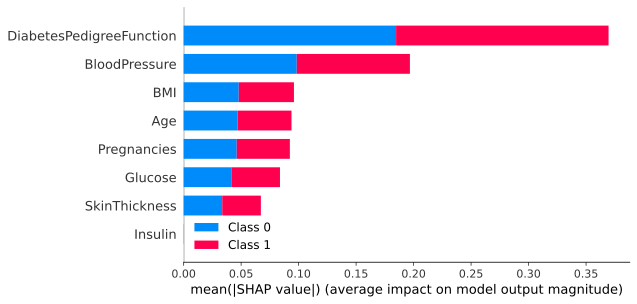

In [106]:
shap.initjs()
shap.summary_plot(shap_values, np.around(instance_df, decimals=2), feature_names=feature_names, max_display=8)

#### Example of Explanation for a Single False Negative

In [110]:
instance = false_negatives[5]

[bn, inference, infoBN, markov_blanket] = generate_BN_explanationsMB(instance, label_lst, feature_names, class_var, 
                                                                       encoder, scaler, model, PATH, DATASET_NAME, variance = VAR)
gnb.sideBySide(*[inference, markov_blanket, infoBN ], captions=[ "Inference", "Markov Blanket", "Information BN" ])

Selecting Greedy Hill Climbing Algorithm


##### Report

In [111]:
HTML("<h3>REPORT</h3>" + 
      "<p>Knowing about the patient's <span style='color:red'>Glucose</span> levels makes <span style='color:red'>SkinThickness</span>, <span style='color:red'>Insulin</span>, " +
      "<span style='color:red'>BMI</span>, <span style='color:red'>Age</span> and <span style='color:red'>DiabetesPedigreeFunction</span> "+
      "NOT RELEVANT to assess <span style='color:red'>Diabetes</span>.</p>"+
      "<p>The features CONTRIBUTING for <span style='color:red'>Diabetes</span> are <span style='color:red'>BloodPressure</span>" +
     " and <span style='color:red'>Pregnancies</span>.</p>"+
     "<p><b>Recommendation:</b> Given the confidence of the explanation (100%), the model is <span style='color:red'><b>certain that the patient has Diabetes</b></span></p>")



##### Comparison with LIME

Time taken to create explainer: 0.01 seconds


Time taken to provide explanation 0.62 seconds


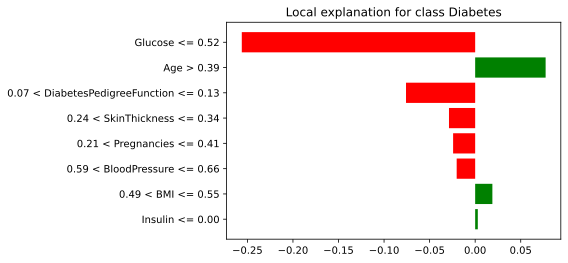

In [112]:
MAX_FEAT = 8

start_time = time.time()

# LIME has one explainer for all the models
explainer = lime_tabular.LimeTabularExplainer(X_train, feature_names= feature_names, 
                                                  class_names=["No Diabetes", "Diabetes"], verbose=False, mode='classification')

elapsed = time.time() - start_time

print ("Time taken to create explainer:", round(elapsed, 2), "seconds")

start_time = time.time()
# explain instance
patients_feat = np.array(instance['scaled_vector'])
exp = explainer.explain_instance(patients_feat, model.predict, num_features = MAX_FEAT)

# Show the predictions
exp.show_in_notebook(show_table=True)

elapsed = time.time() - start_time
print("Time taken to provide explanation", round (elapsed, 2), "seconds")

#Save the explanation
explanation_plot = exp.as_pyplot_figure()
#plt.tight_layout()
plt.show()

##### Comparison with SHAP

Using 374 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


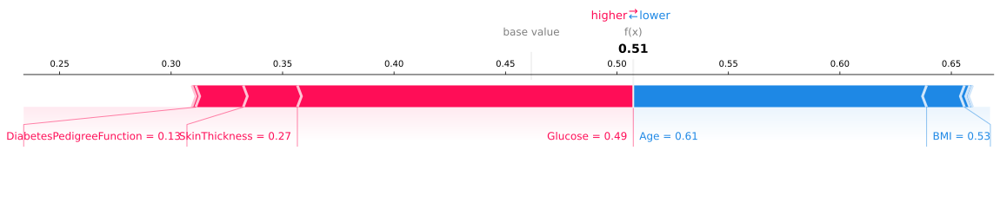

In [113]:

#Convert to dataframe
X_train_df = pd.DataFrame(data = X_train, columns = feature_names)

# load JS visualization code to notebook
shap.initjs()
shap_explainer = shap.KernelExplainer(model.predict, X_train_df)

instance_df = pd.DataFrame(data = [instance['scaled_vector']], columns = feature_names)

shap_values = shap_explainer.shap_values(instance_df)
exp = shap.force_plot(shap_explainer.expected_value[0], shap_values[0], np.around(instance_df, decimals=2), matplotlib = True, show = False)


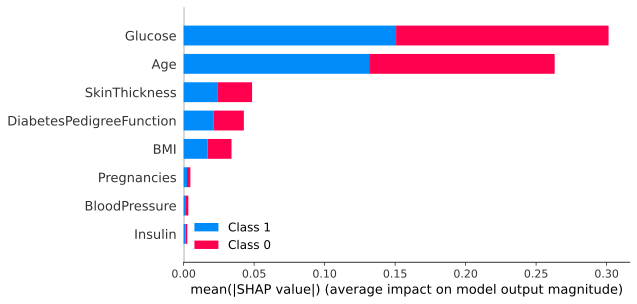

In [114]:
shap.initjs()
shap.summary_plot(shap_values, np.around(instance_df, decimals=2), feature_names=feature_names, max_display=8)

#### Example of Explanation for a Single True Negative

In [115]:
instance = true_negatives[16]

[bn, inference, infoBN, markov_blanket] = generate_BN_explanationsMB(instance, label_lst, feature_names, class_var, 
                                                                       encoder, scaler, model, PATH, DATASET_NAME, variance = VAR)
gnb.sideBySide(*[inference, markov_blanket, infoBN ], captions=[ "Inference", "Markov Blanket", "Information BN" ])

Selecting Greedy Hill Climbing Algorithm


##### Report

In [116]:
HTML("<h3>REPORT</h3>" + 
      "<p>Knowing about the patient's <span style='color:red'>Glucose</span> levels makes <span style='color:red'>SkinThickness</span>, <span style='color:red'>Insulin</span>, " +
      "<span style='color:red'>BMI</span>, <span style='color:red'>Age</span> and <span style='color:red'>DiabetesPedigreeFunction</span> "+
      "NOT RELEVANT to assess <span style='color:red'>Diabetes</span>.</p>"+
      "<p>The features CONTRIBUTING for <span style='color:red'>Diabetes</span> are <span style='color:red'>BloodPressure</span>" +
     " and <span style='color:red'>Pregnancies</span>.</p>"+
     "<p><b>Recommendation:</b> Given the confidence of the explanation (100%), the model is <span style='color:red'><b>certain that the patient has Diabetes</b></span></p>")



##### Comparison with LIME

Time taken to create explainer: 0.01 seconds


Time taken to provide explanation 0.55 seconds


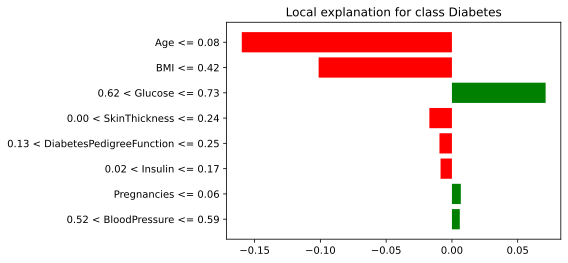

In [117]:
MAX_FEAT = 8

start_time = time.time()

# LIME has one explainer for all the models
explainer = lime_tabular.LimeTabularExplainer(X_train, feature_names= feature_names, 
                                                  class_names=["No Diabetes", "Diabetes"], verbose=False, mode='classification')

elapsed = time.time() - start_time

print ("Time taken to create explainer:", round(elapsed, 2), "seconds")

start_time = time.time()
# explain instance
patients_feat = np.array(instance['scaled_vector'])
exp = explainer.explain_instance(patients_feat, model.predict, num_features = MAX_FEAT)

# Show the predictions
exp.show_in_notebook(show_table=True)

elapsed = time.time() - start_time
print("Time taken to provide explanation", round (elapsed, 2), "seconds")

#Save the explanation
explanation_plot = exp.as_pyplot_figure()
#plt.tight_layout()
plt.show()

##### Comparison with SHAP

Using 374 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


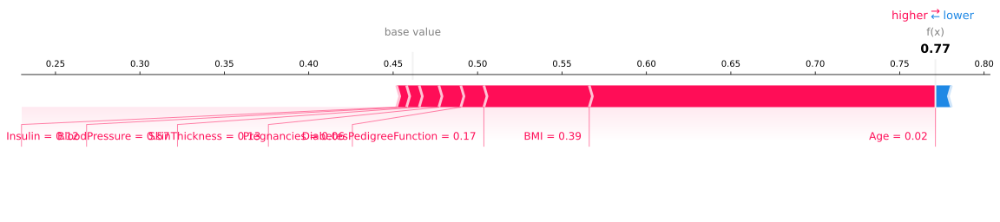

In [118]:
#Convert to dataframe
X_train_df = pd.DataFrame(data = X_train, columns = feature_names)

# load JS visualization code to notebook
shap.initjs()
shap_explainer = shap.KernelExplainer(model.predict, X_train_df)

instance_df = pd.DataFrame(data = [instance['scaled_vector']], columns = feature_names)

shap_values = shap_explainer.shap_values(instance_df)
exp = shap.force_plot(shap_explainer.expected_value[0], shap_values[0], np.around(instance_df, decimals=2), matplotlib = True, show = False)


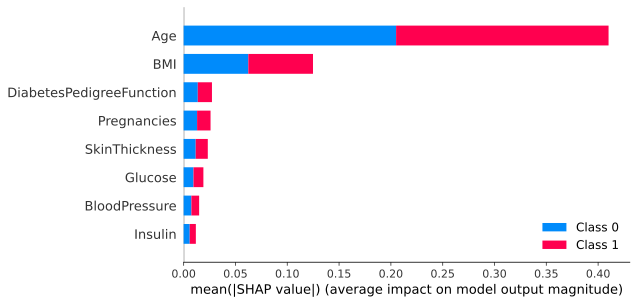

In [119]:
shap.initjs()
shap.summary_plot(shap_values, np.around(instance_df, decimals=2), feature_names=feature_names, max_display=8)

### Explanations for TRUE POSITIVES

In [ ]:
indx = 0
for instance in true_positives:
  print("INDEX = (%d, %d)" %((instance['index'], indx) ))
  [bn, inference, infoBN, markov_blanket] = generate_BN_explanationsMB(instance, label_lst, feature_names, class_var, 
                                                                       encoder, scaler, model, PATH, DATASET_NAME, variance = VAR)
          
  gnb.sideBySide(*[inference, markov_blanket, infoBN ], captions=[ "Inference", "Markov Blanket", "Information BN" ])
  print(" \n\n\n")
  indx = indx + 1

Output hidden; open in https://colab.research.google.com to view.

### Explanations for FALSE POSITIVES

In [ ]:
indx = 0
for instance in false_positives:
  print("INDEX = (%d, %d)" %((instance['index'], indx) ))
  [bn, inference, infoBN, markov_blanket] = generate_BN_explanationsMB(instance, label_lst, feature_names, class_var, 
                                                                       encoder, scaler, model, PATH, DATASET_NAME, variance = 0.25)
          
  gnb.sideBySide(*[inference, markov_blanket, infoBN ], captions=[ "Inference", "Markov Blanket", "Information BN" ])
  print(" \n\n\n")
  indx = indx + 1

Output hidden; open in https://colab.research.google.com to view.

### Explanations for FALSE NEGATIVES

In [ ]:
indx = 0
for instance in false_negatives:
  print("INDEX = (%d, %d)" %((instance['index'], indx) ))
  [bn, inference, infoBN, markov_blanket] = generate_BN_explanationsMB(instance, label_lst, feature_names, class_var, 
                                                                       encoder, scaler, model, PATH, DATASET_NAME, variance = VAR)
          
  gnb.sideBySide(*[inference, markov_blanket, infoBN ], captions=[ "Inference", "Markov Blanket", "Information BN" ])
  print(" \n\n\n")
  indx = indx + 1

INDEX = (5, 0)
Selecting Greedy Hill Climbing Algorithm


 



INDEX = (15, 1)
Selecting Greedy Hill Climbing Algorithm


no_name <!-- 0 --> 0 Pregnancies <!-- 8 --> 8 Diabetes? <!-- 0->8 --> 0->8 <!-- 2 --> 2 BloodPressure <!-- 2->8 --> 2->8


 



INDEX = (24, 2)
Selecting Greedy Hill Climbing Algorithm


 



INDEX = (29, 3)
Selecting Greedy Hill Climbing Algorithm


 



INDEX = (70, 4)
Selecting Greedy Hill Climbing Algorithm


 



INDEX = (75, 5)
Selecting Greedy Hill Climbing Algorithm


 



INDEX = (76, 6)
Selecting Greedy Hill Climbing Algorithm


### Explanations for TRUE NEGATIVES

In [ ]:
indx = 0
for instance in true_negatives:
  print("INDEX = (%d, %d)" %((instance['index'], indx) ))
  [bn, inference, infoBN, markov_blanket] = generate_BN_explanationsMB(instance, label_lst, feature_names, class_var, 
                                                                       encoder, scaler, model, PATH, DATASET_NAME, variance = VAR)
          
  gnb.sideBySide(*[inference, markov_blanket, infoBN ], captions=[ "Inference", "Markov Blanket", "Information BN" ])
  print(" \n\n\n")
  indx = indx + 1

Output hidden; open in https://colab.research.google.com to view.

## Generating Explanations with LIME

In [36]:
MAX_FEAT = 6

start_time = time.time()

# LIME has one explainer for all the models
explainer = lime_tabular.LimeTabularExplainer(X_train, feature_names= feature_names, 
                                                  class_names=["No Diabetes", "Diabetes"], verbose=False, mode='classification')

elapsed = time.time() - start_time

print ("Time taken to create explainer:", round(elapsed, 2), "seconds")

Time taken to create explainer: 0.01 seconds


### True Positives

In [38]:
for instance in true_positives:

    print("INDEX = %d" %instance['index'])
    patients_feat = np.array(instance['scaled_vector'])
    
    start_time = time.time()
    # explain instance
    exp = explainer.explain_instance(patients_feat, model.predict, num_features = 8 )
    
    # Show the predictions
    exp.show_in_notebook(show_table=True)
    
    elapsed = time.time() - start_time
    print("Time taken to provide explanation", round (elapsed, 2), "seconds")
    
    #Save the explanation
    explanation_plot = exp.as_pyplot_figure()
    plt.tight_layout()
    #explanation_plot.savefig(PATH+"explanations/diabetes/LIME/true_positives/IDX_" + str(instance['index'])+".png", dpi=300)
    plt.show()
    
    print("\n--------------------------------------------------------------------------------------------\n")


Output hidden; open in https://colab.research.google.com to view.

### False Positives

In [120]:
for instance in false_positives:

    print("INDEX = %d" %instance['index'])
    patients_feat = np.array(instance['scaled_vector'])
    
    start_time = time.time()
    # explain instance
    exp = explainer.explain_instance(patients_feat, model.predict, num_features = 8 )
    
    # Show the predictions
    exp.show_in_notebook(show_table=True)
    
    elapsed = time.time() - start_time
    print("Time taken to provide explanation", round (elapsed, 2), "seconds")
    
    #Save the explanation
    explanation_plot = exp.as_pyplot_figure()
    plt.tight_layout()
    #explanation_plot.savefig(PATH+"explanations/diabetes/LIME/true_positives/IDX_" + str(instance['index'])+".png", dpi=300)
    plt.show()
    
    print("\n--------------------------------------------------------------------------------------------\n")


Output hidden; open in https://colab.research.google.com to view.

### False Negatives

In [121]:
for instance in false_negatives:

    print("INDEX = %d" %instance['index'])
    patients_feat = np.array(instance['scaled_vector'])
    
    start_time = time.time()
    # explain instance
    exp = explainer.explain_instance(patients_feat, model.predict, num_features = 8 )
    
    # Show the predictions
    exp.show_in_notebook(show_table=True)
    
    elapsed = time.time() - start_time
    print("Time taken to provide explanation", round (elapsed, 2), "seconds")
    
    #Save the explanation
    explanation_plot = exp.as_pyplot_figure()
    plt.tight_layout()
    #explanation_plot.savefig(PATH+"explanations/diabetes/LIME/true_positives/IDX_" + str(instance['index'])+".png", dpi=300)
    plt.show()
    
    print("\n--------------------------------------------------------------------------------------------\n")


Output hidden; open in https://colab.research.google.com to view.

### True Negatives

In [122]:
for instance in true_negatives:

    print("INDEX = %d" %instance['index'])
    patients_feat = np.array(instance['scaled_vector'])
    
    start_time = time.time()
    # explain instance
    exp = explainer.explain_instance(patients_feat, model.predict, num_features = 8 )
    
    # Show the predictions
    exp.show_in_notebook(show_table=True)
    
    elapsed = time.time() - start_time
    print("Time taken to provide explanation", round (elapsed, 2), "seconds")
    
    #Save the explanation
    explanation_plot = exp.as_pyplot_figure()
    plt.tight_layout()
    #explanation_plot.savefig(PATH+"explanations/diabetes/LIME/true_positives/IDX_" + str(instance['index'])+".png", dpi=300)
    plt.show()
    
    print("\n--------------------------------------------------------------------------------------------\n")


Output hidden; open in https://colab.research.google.com to view.

## Generating Explanations with SHAP

In [124]:
#Convert to dataframe
X_train_df = pd.DataFrame(data = X_train, columns = feature_names)

# load JS visualization code to notebook
shap.initjs()
shap_explainer = shap.KernelExplainer(model.predict, X_train_df)



Using 374 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


### True Positives

INDEX = 0


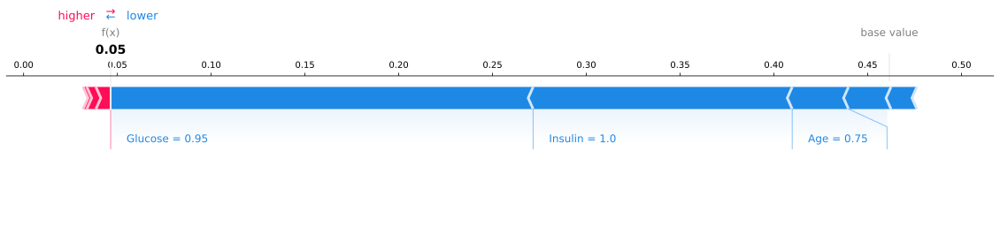

Time taken to provide explanation 3.55 seconds

--------------------------------------------------------------------------------------------

INDEX = 1


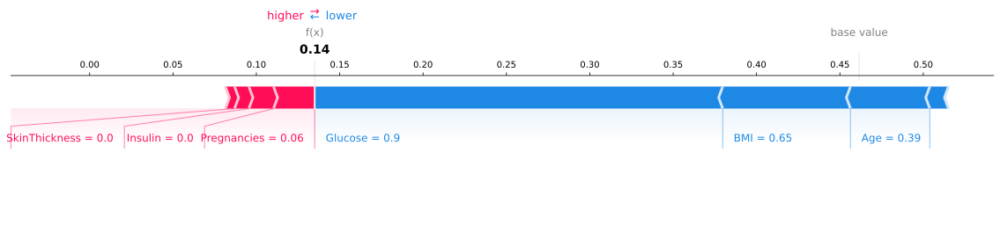

Time taken to provide explanation 3.71 seconds

--------------------------------------------------------------------------------------------

INDEX = 3


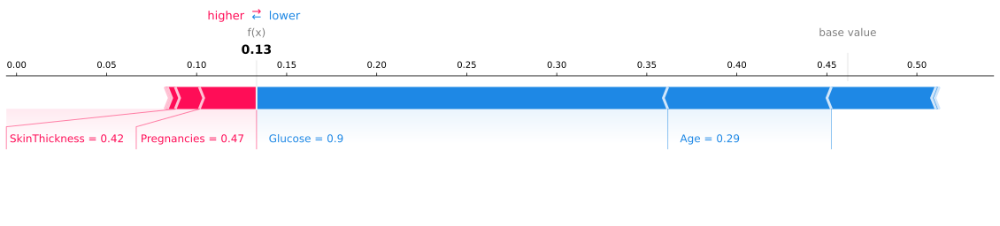

Time taken to provide explanation 3.6 seconds

--------------------------------------------------------------------------------------------

INDEX = 7


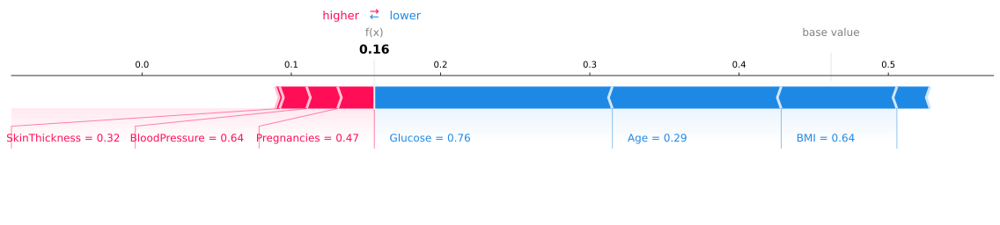

Time taken to provide explanation 3.72 seconds

--------------------------------------------------------------------------------------------

INDEX = 10


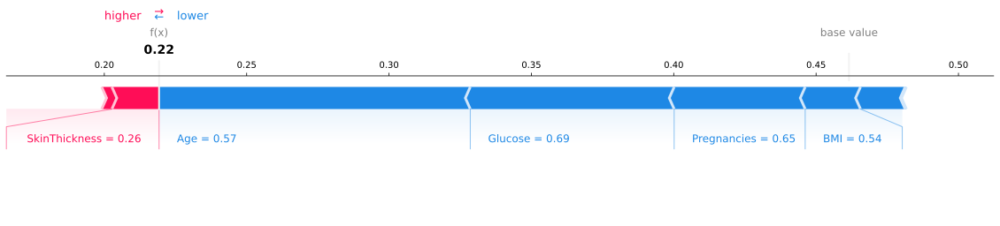

Time taken to provide explanation 3.62 seconds

--------------------------------------------------------------------------------------------

INDEX = 14


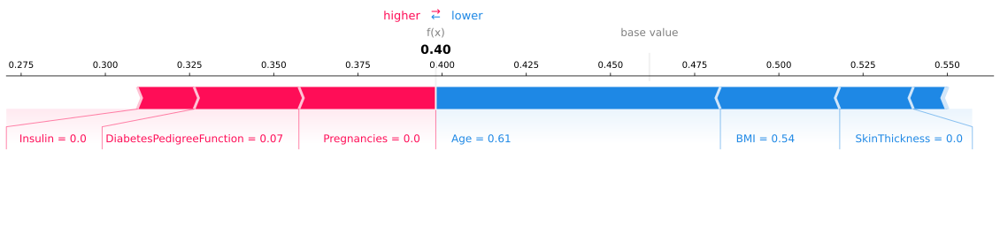

Time taken to provide explanation 3.74 seconds

--------------------------------------------------------------------------------------------

INDEX = 19


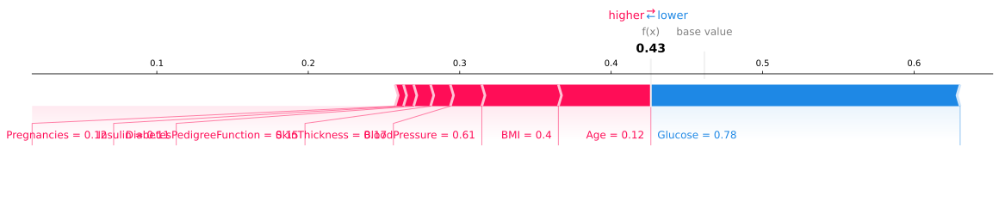

Time taken to provide explanation 3.82 seconds

--------------------------------------------------------------------------------------------

INDEX = 20


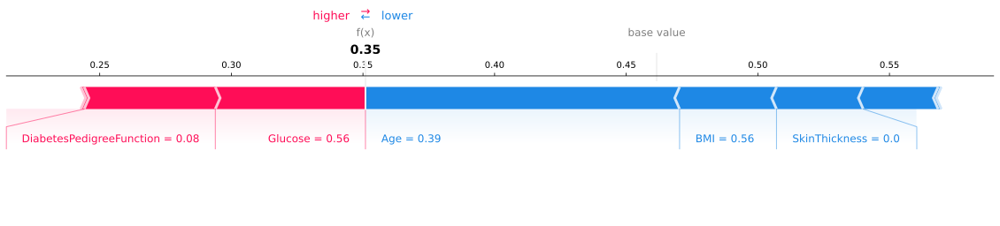

Time taken to provide explanation 3.66 seconds

--------------------------------------------------------------------------------------------

INDEX = 31


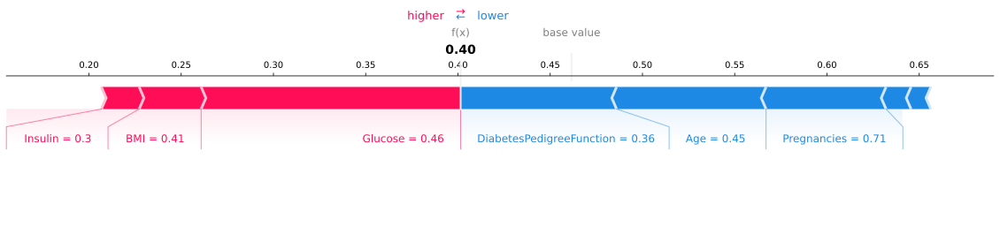

Time taken to provide explanation 3.71 seconds

--------------------------------------------------------------------------------------------

INDEX = 32


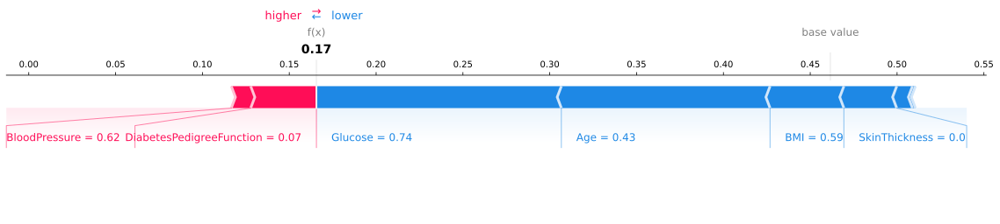

Time taken to provide explanation 3.91 seconds

--------------------------------------------------------------------------------------------

INDEX = 35


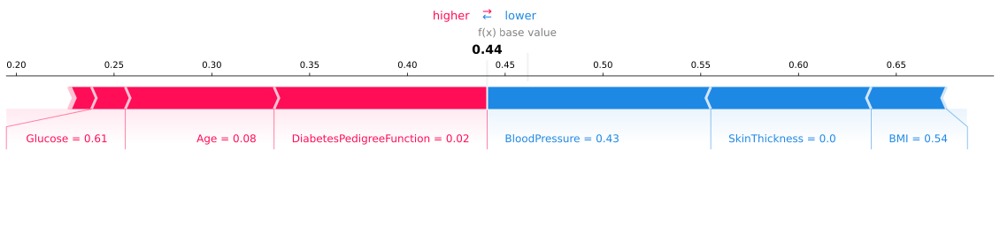

Time taken to provide explanation 3.67 seconds

--------------------------------------------------------------------------------------------

INDEX = 37


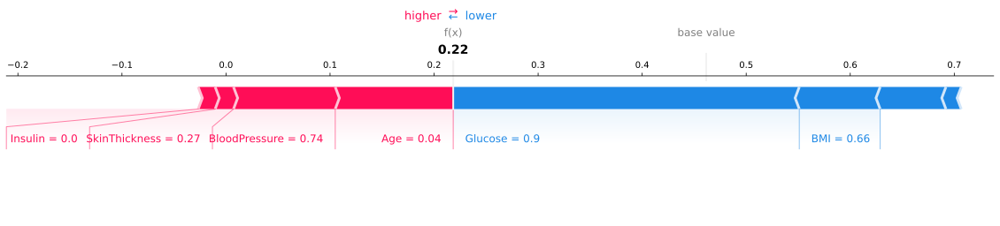

Time taken to provide explanation 3.81 seconds

--------------------------------------------------------------------------------------------

INDEX = 39


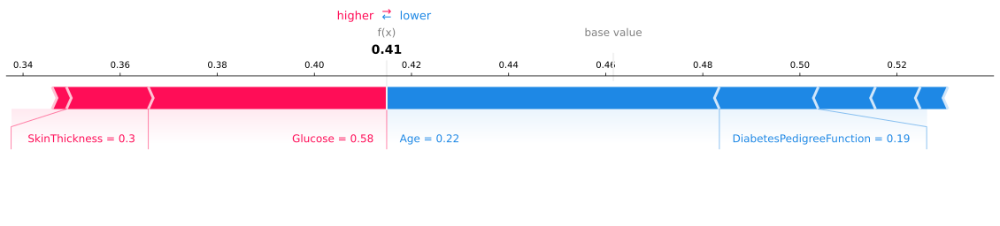

Time taken to provide explanation 3.71 seconds

--------------------------------------------------------------------------------------------

INDEX = 41


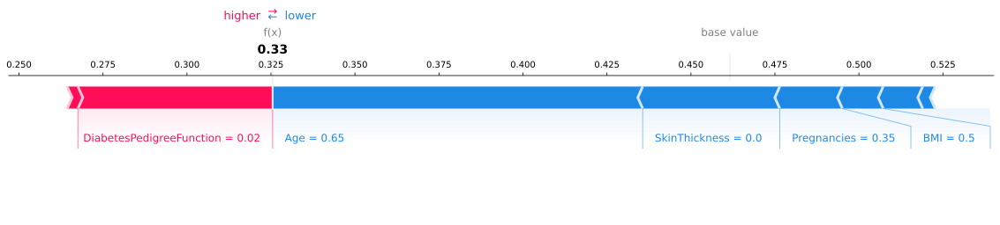

Time taken to provide explanation 3.71 seconds

--------------------------------------------------------------------------------------------

INDEX = 42


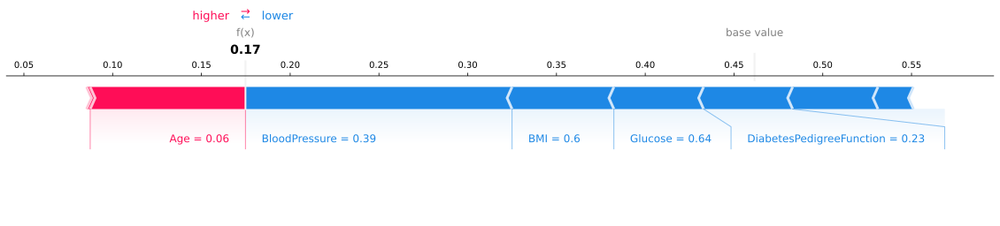

Time taken to provide explanation 3.67 seconds

--------------------------------------------------------------------------------------------

INDEX = 44


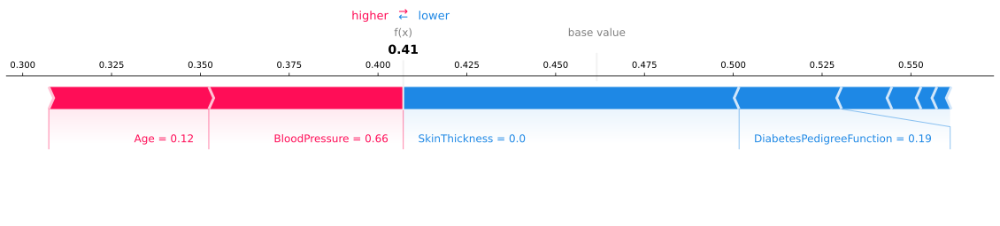

Time taken to provide explanation 3.67 seconds

--------------------------------------------------------------------------------------------

INDEX = 45


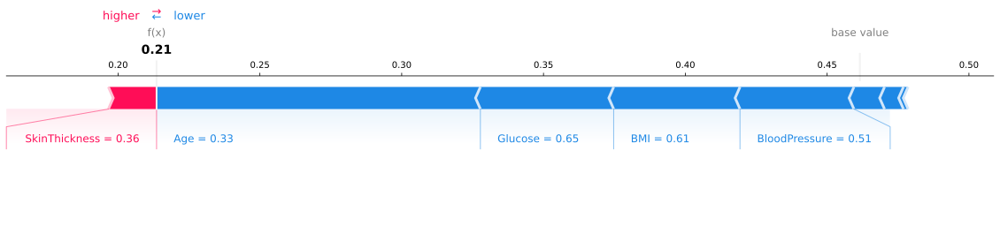

Time taken to provide explanation 3.59 seconds

--------------------------------------------------------------------------------------------

INDEX = 47


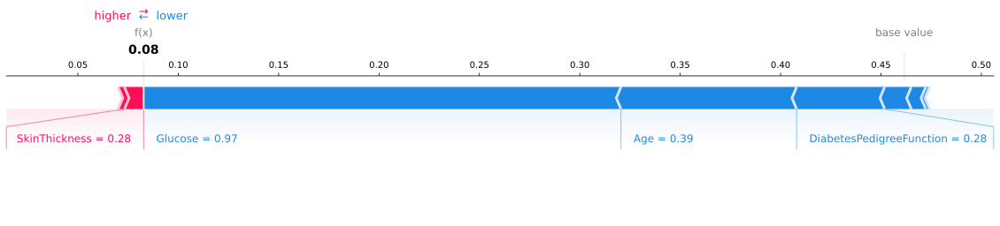

Time taken to provide explanation 3.68 seconds

--------------------------------------------------------------------------------------------

INDEX = 50


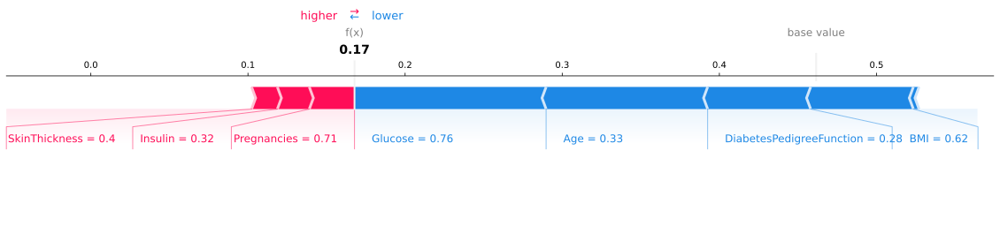

Time taken to provide explanation 3.74 seconds

--------------------------------------------------------------------------------------------

INDEX = 52


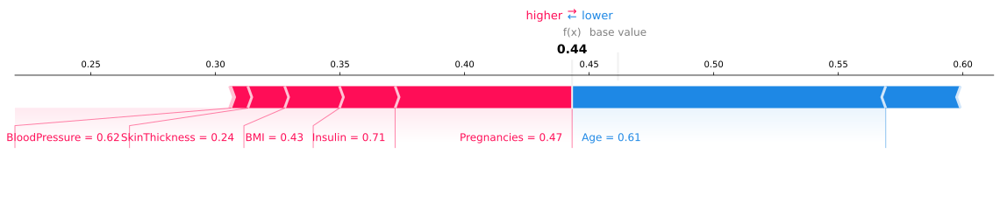

Time taken to provide explanation 3.74 seconds

--------------------------------------------------------------------------------------------

INDEX = 53


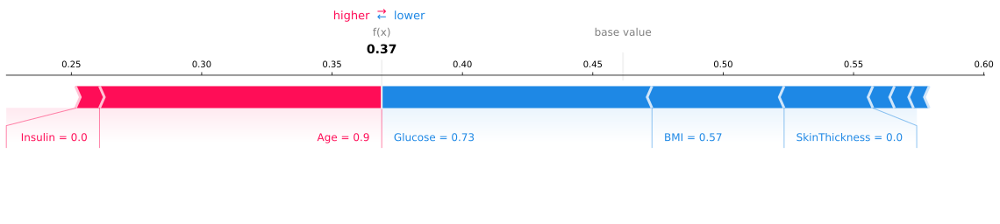

Time taken to provide explanation 3.69 seconds

--------------------------------------------------------------------------------------------

INDEX = 54


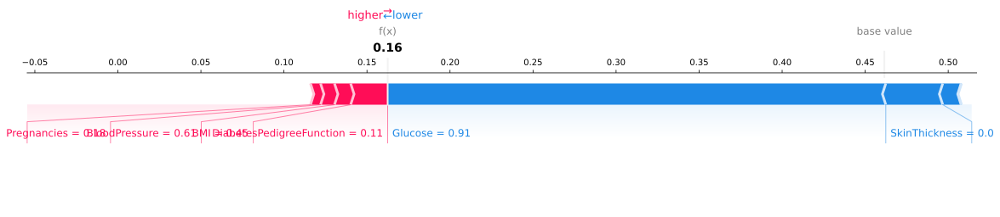

Time taken to provide explanation 3.74 seconds

--------------------------------------------------------------------------------------------

INDEX = 61


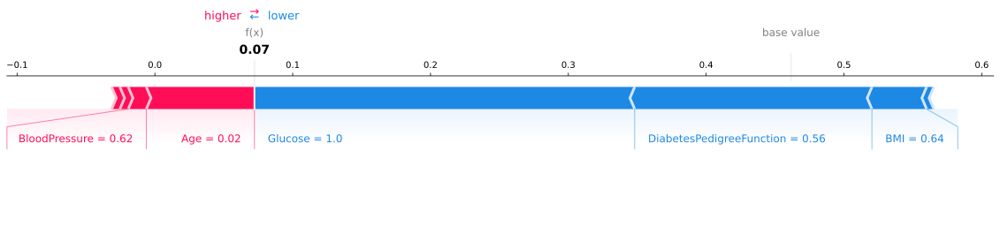

Time taken to provide explanation 3.62 seconds

--------------------------------------------------------------------------------------------

INDEX = 62


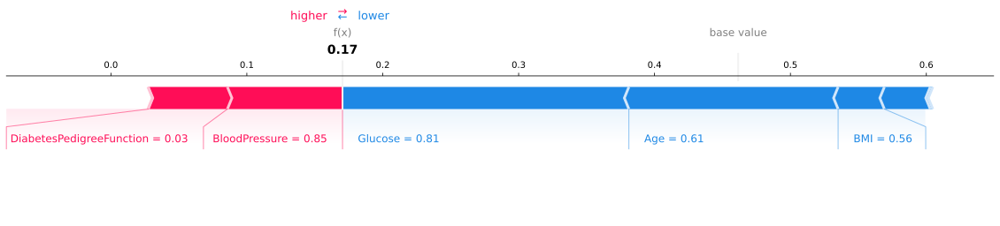

Time taken to provide explanation 3.64 seconds

--------------------------------------------------------------------------------------------

INDEX = 63


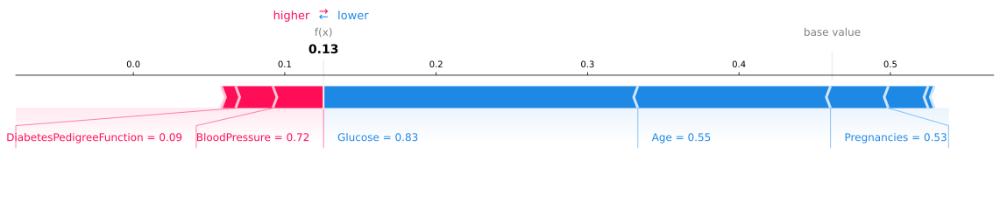

Time taken to provide explanation 3.63 seconds

--------------------------------------------------------------------------------------------

INDEX = 65


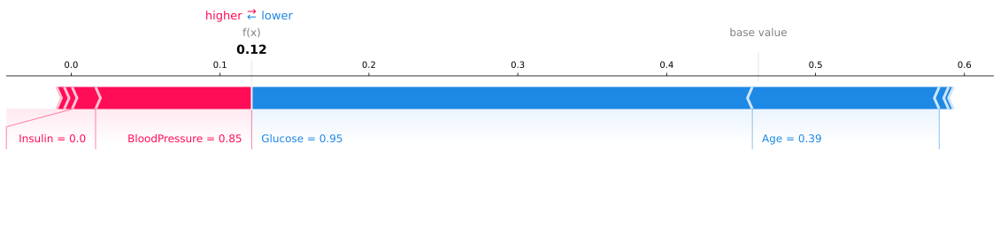

Time taken to provide explanation 3.56 seconds

--------------------------------------------------------------------------------------------

INDEX = 67


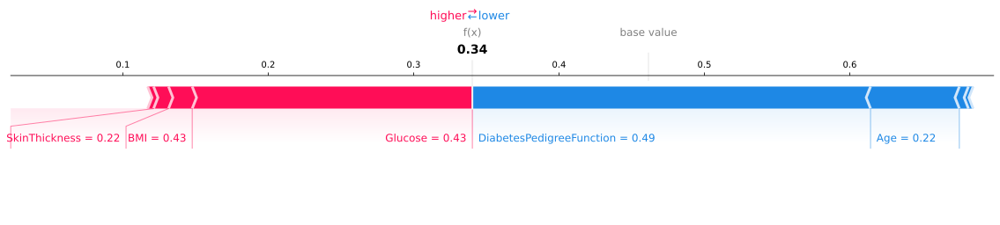

Time taken to provide explanation 3.69 seconds

--------------------------------------------------------------------------------------------

INDEX = 68


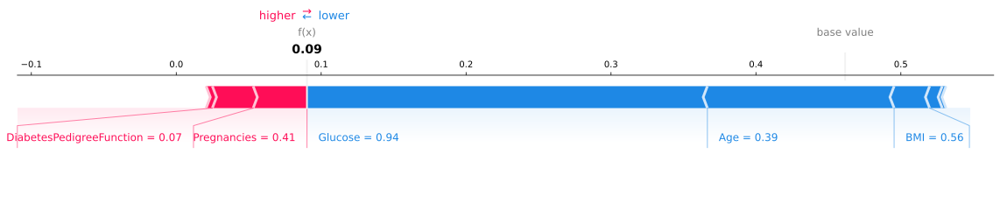

Time taken to provide explanation 3.66 seconds

--------------------------------------------------------------------------------------------

INDEX = 71


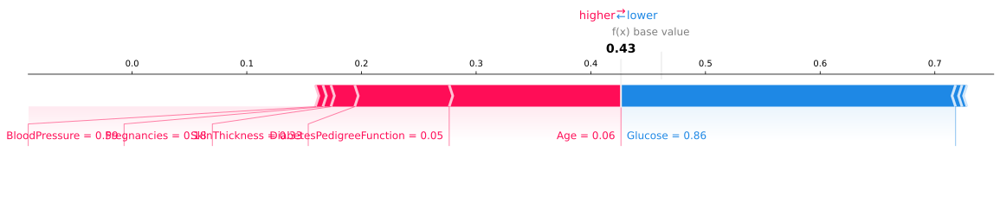

Time taken to provide explanation 3.87 seconds

--------------------------------------------------------------------------------------------

INDEX = 72


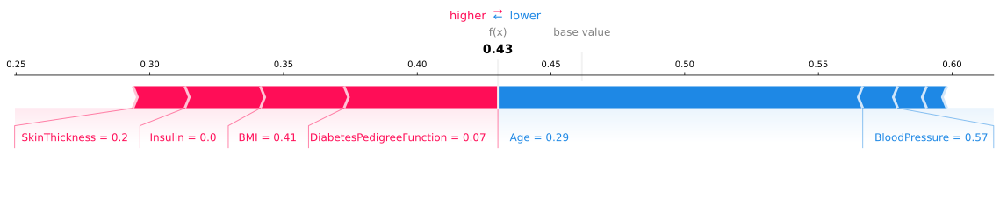

Time taken to provide explanation 3.8 seconds

--------------------------------------------------------------------------------------------

INDEX = 74


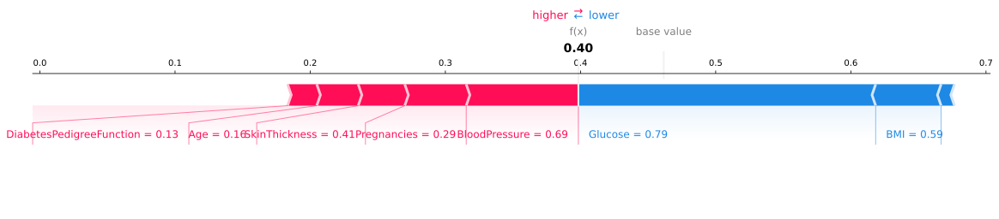

Time taken to provide explanation 3.75 seconds

--------------------------------------------------------------------------------------------

INDEX = 78


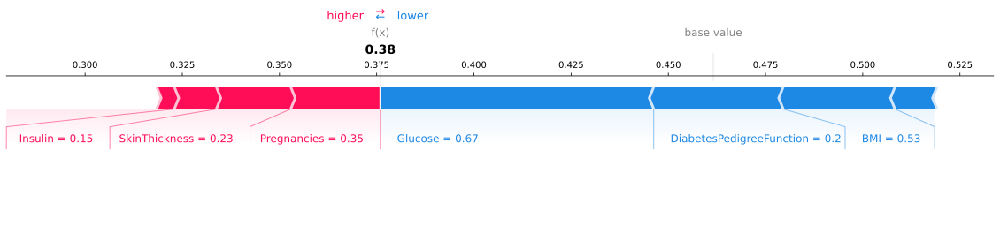

Time taken to provide explanation 3.78 seconds

--------------------------------------------------------------------------------------------

INDEX = 79


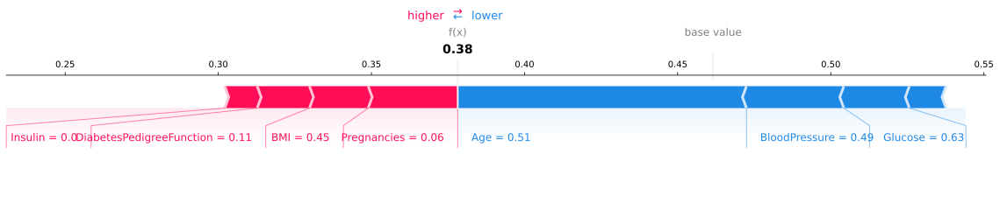

Time taken to provide explanation 3.77 seconds

--------------------------------------------------------------------------------------------



In [131]:
for instance in true_positives:

    print("INDEX = %d" %instance['index'])
    patients_feat = pd.DataFrame(data = [instance['scaled_vector']], columns = feature_names)

    start_time = time.time()
    
    # explain instance
    shap_values = shap_explainer.shap_values(patients_feat)
    exp1 = shap.force_plot(shap_explainer.expected_value[0], shap_values[0], np.around(patients_feat, decimals=2), matplotlib = True, show = True)

    elapsed = time.time() - start_time
    print("Time taken to provide explanation", round (elapsed, 2), "seconds")
    
    print("\n--------------------------------------------------------------------------------------------\n")


INDEX = 0


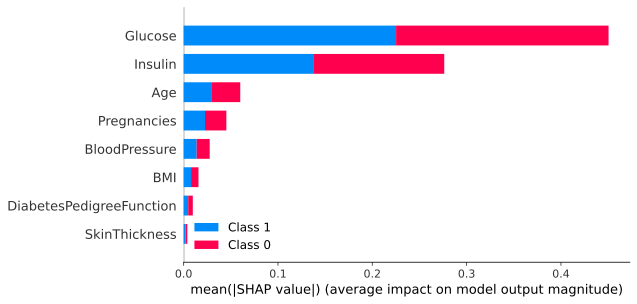

Time taken to provide explanation 3.22 seconds

--------------------------------------------------------------------------------------------

INDEX = 1


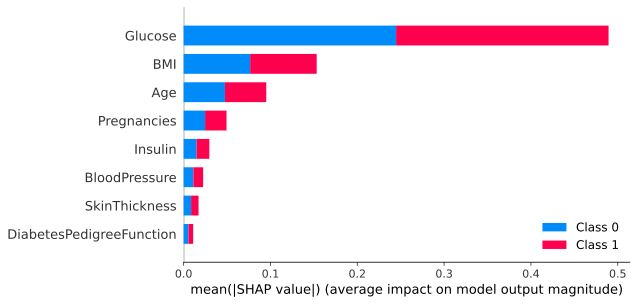

Time taken to provide explanation 3.19 seconds

--------------------------------------------------------------------------------------------

INDEX = 3


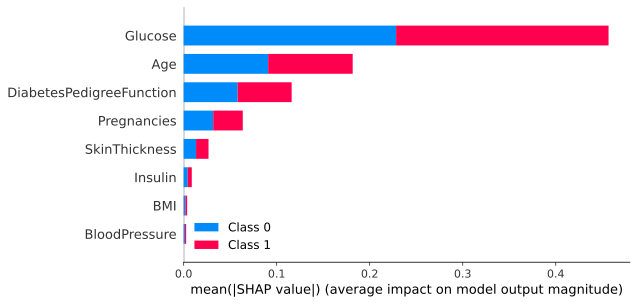

Time taken to provide explanation 3.23 seconds

--------------------------------------------------------------------------------------------

INDEX = 7


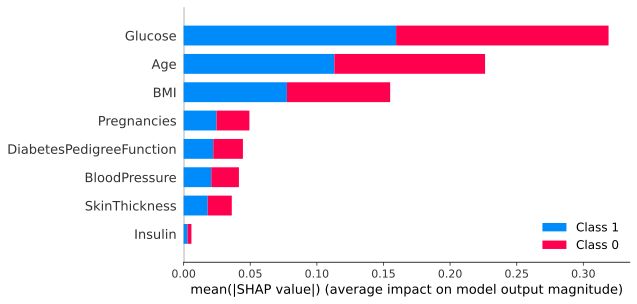

Time taken to provide explanation 3.23 seconds

--------------------------------------------------------------------------------------------

INDEX = 10


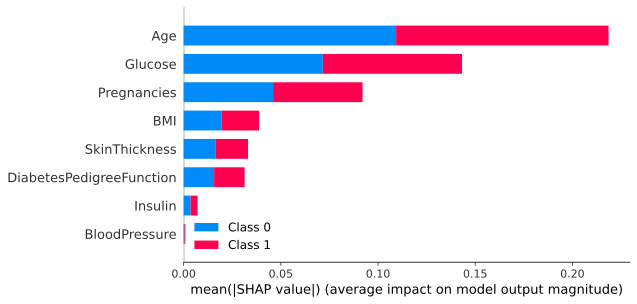

Time taken to provide explanation 3.28 seconds

--------------------------------------------------------------------------------------------

INDEX = 14


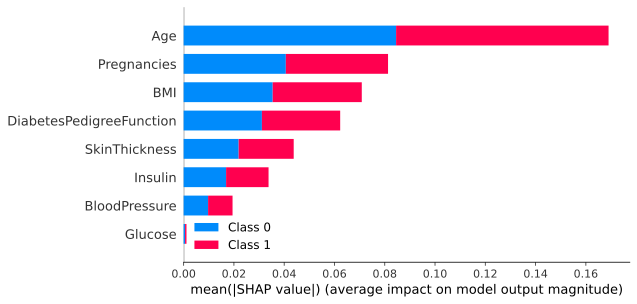

Time taken to provide explanation 3.22 seconds

--------------------------------------------------------------------------------------------

INDEX = 19


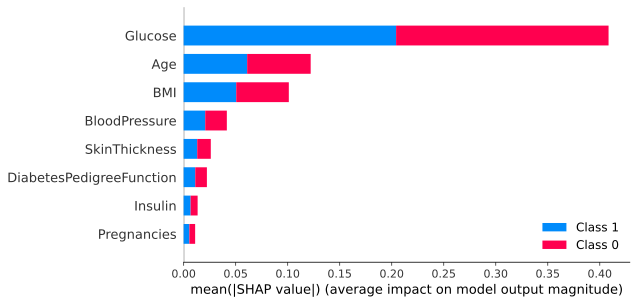

Time taken to provide explanation 3.27 seconds

--------------------------------------------------------------------------------------------

INDEX = 20


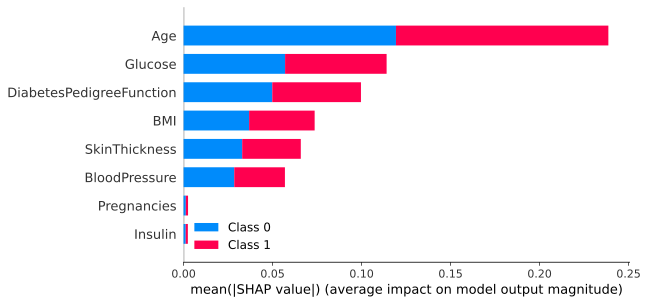

Time taken to provide explanation 3.22 seconds

--------------------------------------------------------------------------------------------

INDEX = 31


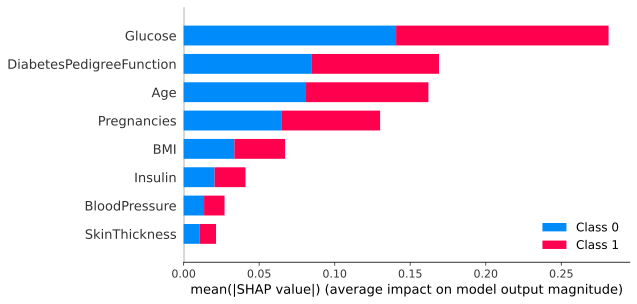

Time taken to provide explanation 3.22 seconds

--------------------------------------------------------------------------------------------

INDEX = 32


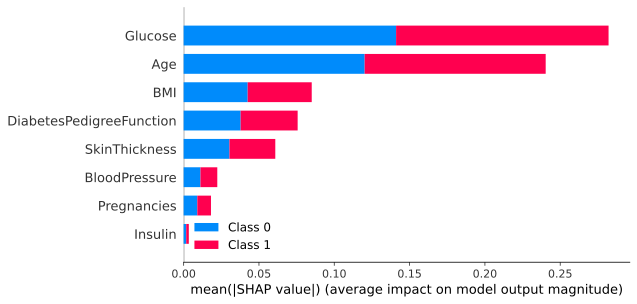

Time taken to provide explanation 3.22 seconds

--------------------------------------------------------------------------------------------

INDEX = 35


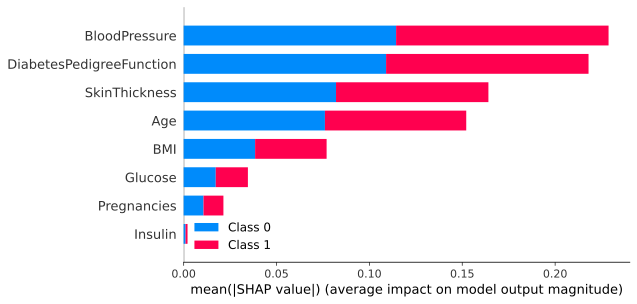

Time taken to provide explanation 3.23 seconds

--------------------------------------------------------------------------------------------

INDEX = 37


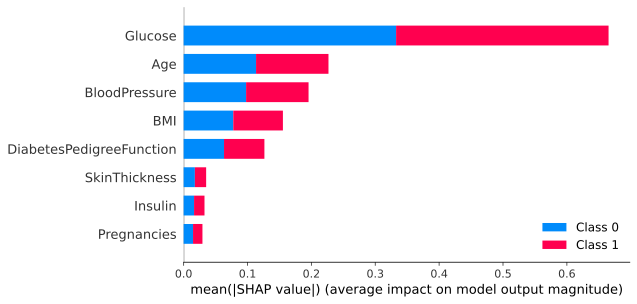

Time taken to provide explanation 3.14 seconds

--------------------------------------------------------------------------------------------

INDEX = 39


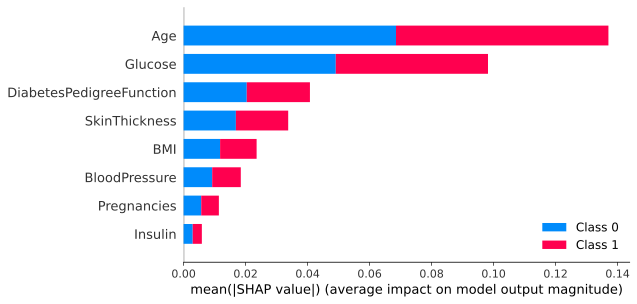

Time taken to provide explanation 3.22 seconds

--------------------------------------------------------------------------------------------

INDEX = 41


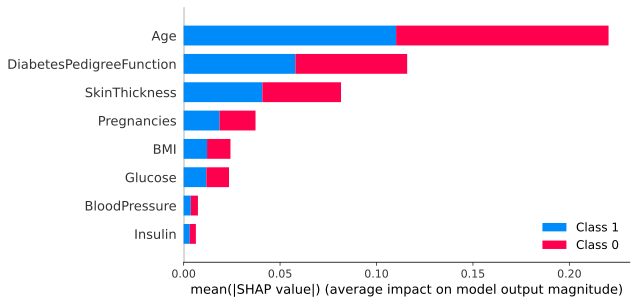

Time taken to provide explanation 3.15 seconds

--------------------------------------------------------------------------------------------

INDEX = 42


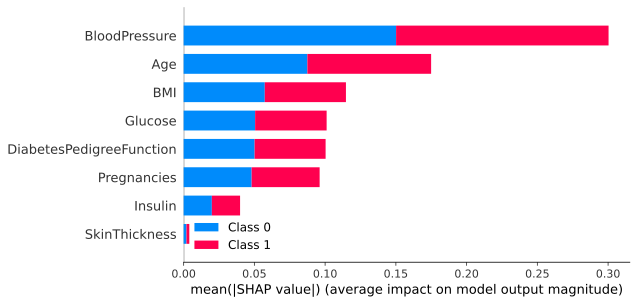

Time taken to provide explanation 3.24 seconds

--------------------------------------------------------------------------------------------

INDEX = 44


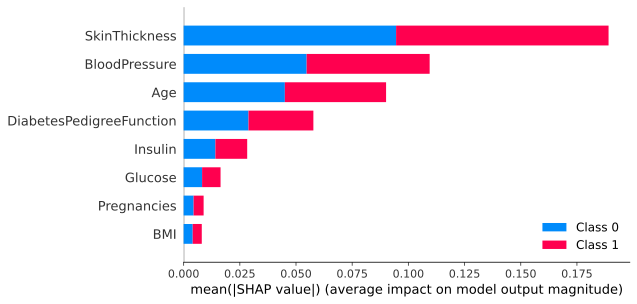

Time taken to provide explanation 3.38 seconds

--------------------------------------------------------------------------------------------

INDEX = 45


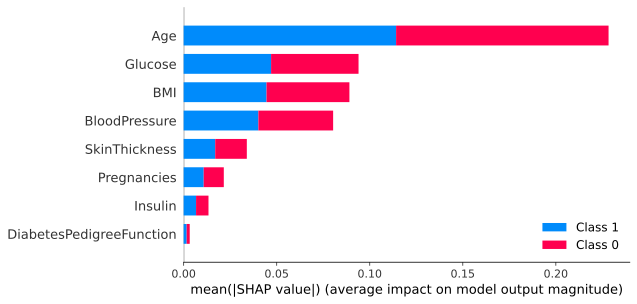

Time taken to provide explanation 3.24 seconds

--------------------------------------------------------------------------------------------

INDEX = 47


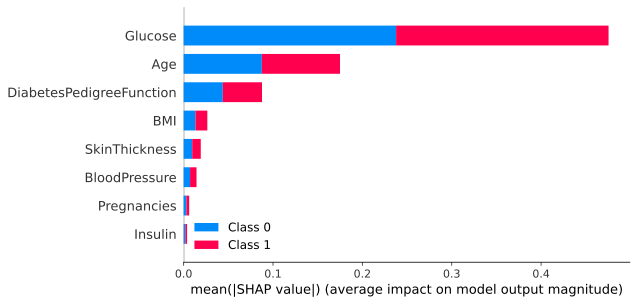

Time taken to provide explanation 3.23 seconds

--------------------------------------------------------------------------------------------

INDEX = 50


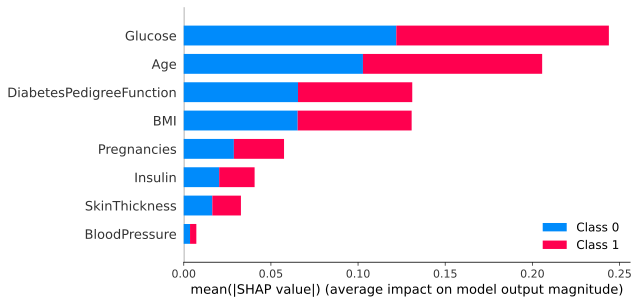

Time taken to provide explanation 3.15 seconds

--------------------------------------------------------------------------------------------

INDEX = 52


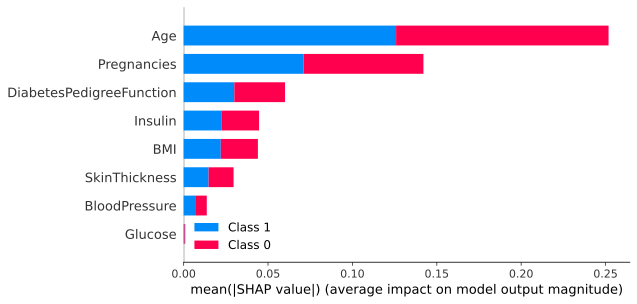

Time taken to provide explanation 3.24 seconds

--------------------------------------------------------------------------------------------

INDEX = 53


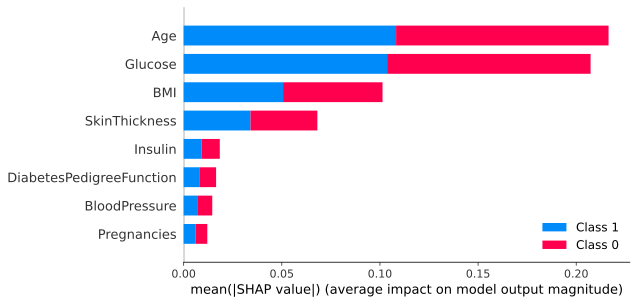

Time taken to provide explanation 3.34 seconds

--------------------------------------------------------------------------------------------

INDEX = 54


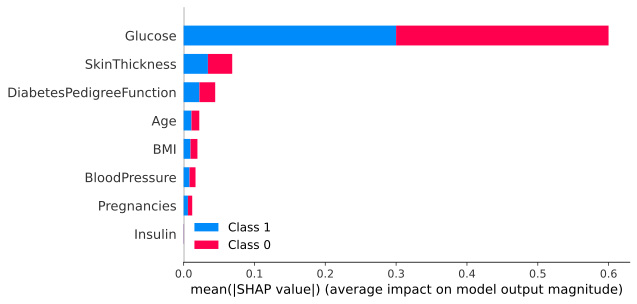

Time taken to provide explanation 3.21 seconds

--------------------------------------------------------------------------------------------

INDEX = 61


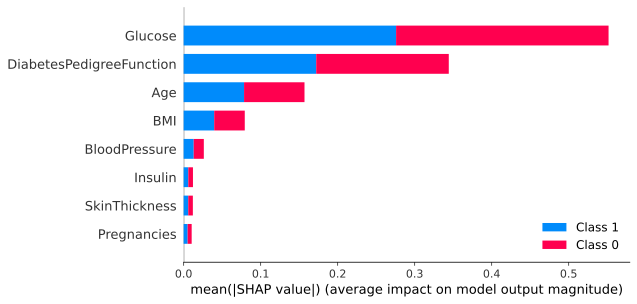

Time taken to provide explanation 3.27 seconds

--------------------------------------------------------------------------------------------

INDEX = 62


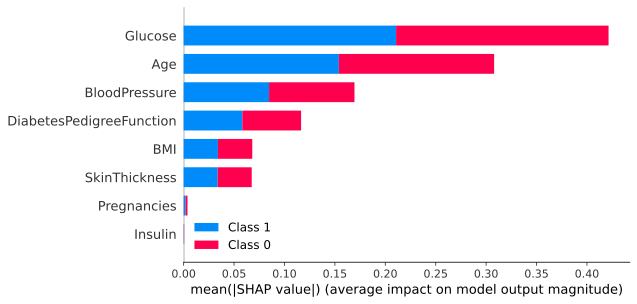

Time taken to provide explanation 3.26 seconds

--------------------------------------------------------------------------------------------

INDEX = 63


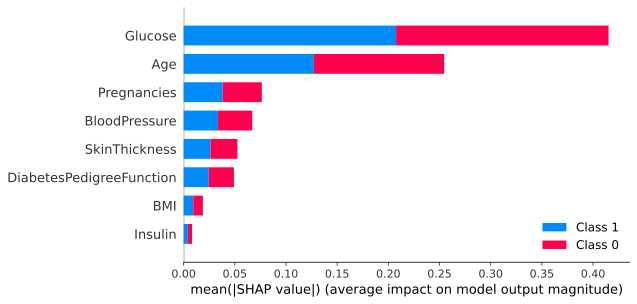

Time taken to provide explanation 3.2 seconds

--------------------------------------------------------------------------------------------

INDEX = 65


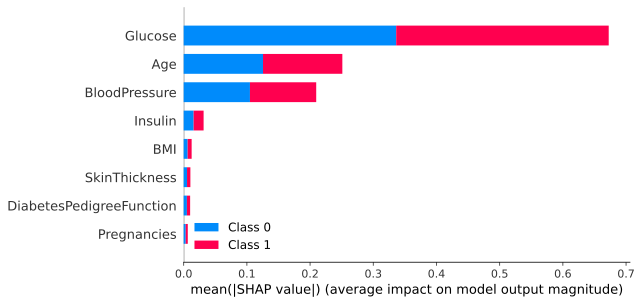

Time taken to provide explanation 3.18 seconds

--------------------------------------------------------------------------------------------

INDEX = 67


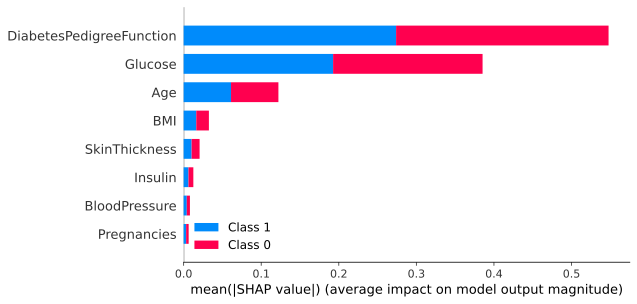

Time taken to provide explanation 3.19 seconds

--------------------------------------------------------------------------------------------

INDEX = 68


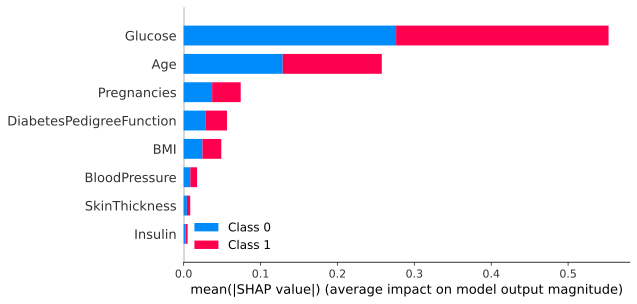

Time taken to provide explanation 3.16 seconds

--------------------------------------------------------------------------------------------

INDEX = 71


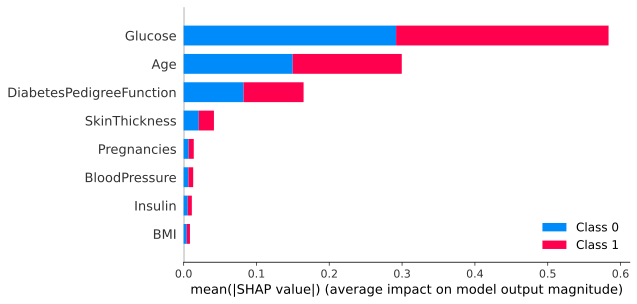

Time taken to provide explanation 3.15 seconds

--------------------------------------------------------------------------------------------

INDEX = 72


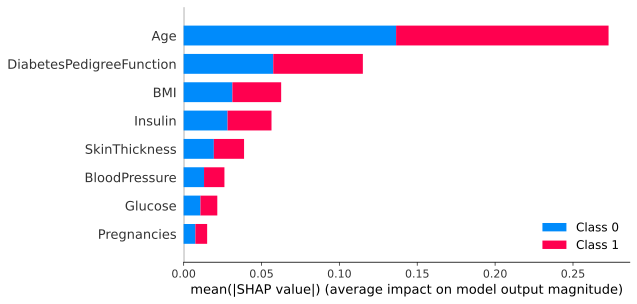

Time taken to provide explanation 3.24 seconds

--------------------------------------------------------------------------------------------

INDEX = 74


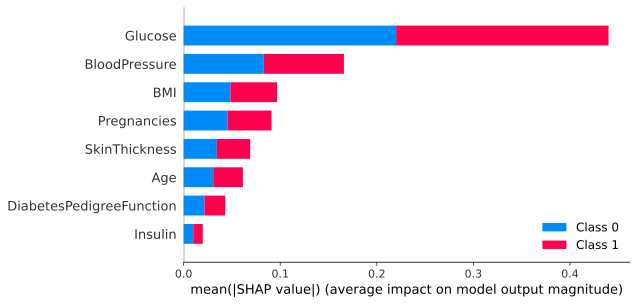

Time taken to provide explanation 3.19 seconds

--------------------------------------------------------------------------------------------

INDEX = 78


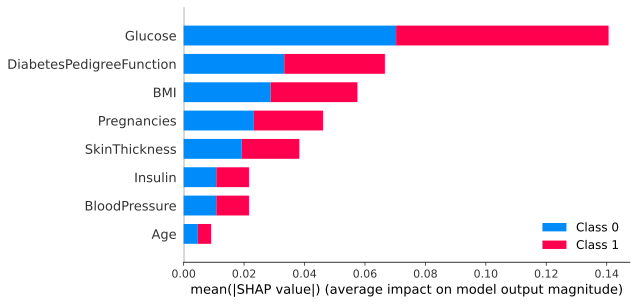

Time taken to provide explanation 3.19 seconds

--------------------------------------------------------------------------------------------

INDEX = 79


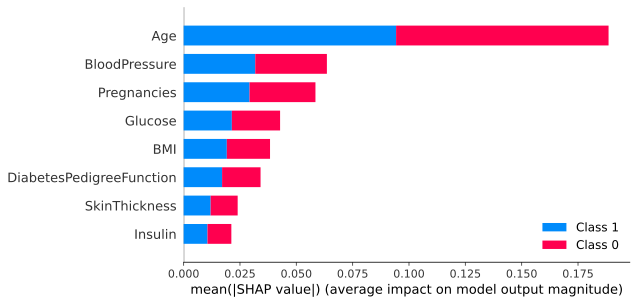

Time taken to provide explanation 3.16 seconds

--------------------------------------------------------------------------------------------



In [132]:
for instance in true_positives:

    print("INDEX = %d" %instance['index'])
    patients_feat = pd.DataFrame(data = [instance['scaled_vector']], columns = feature_names)

    start_time = time.time()
    
    # explain instance
    shap_values = shap_explainer.shap_values(patients_feat)
    exp2 = shap.summary_plot(shap_values, np.around(patients_feat, decimals=2), feature_names=feature_names, max_display=8)

    elapsed = time.time() - start_time
    print("Time taken to provide explanation", round (elapsed, 2), "seconds")
    
    print("\n--------------------------------------------------------------------------------------------\n")



### False Positives

INDEX = 4


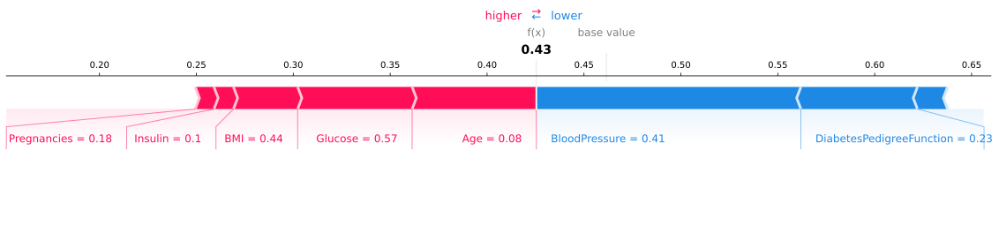

Time taken to provide explanation 3.73 seconds

--------------------------------------------------------------------------------------------

INDEX = 6


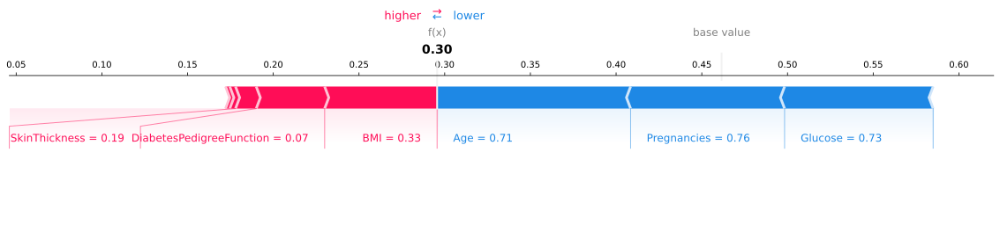

Time taken to provide explanation 3.7 seconds

--------------------------------------------------------------------------------------------

INDEX = 11


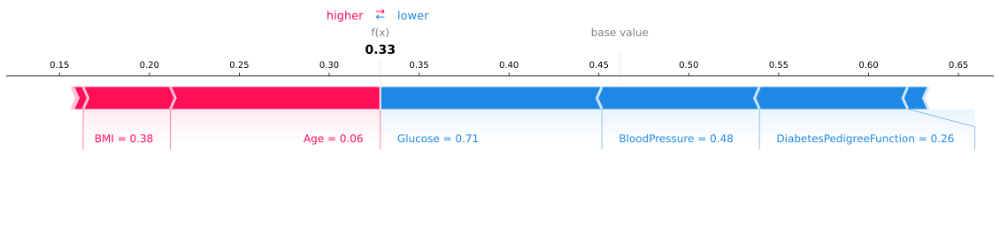

Time taken to provide explanation 3.72 seconds

--------------------------------------------------------------------------------------------

INDEX = 21


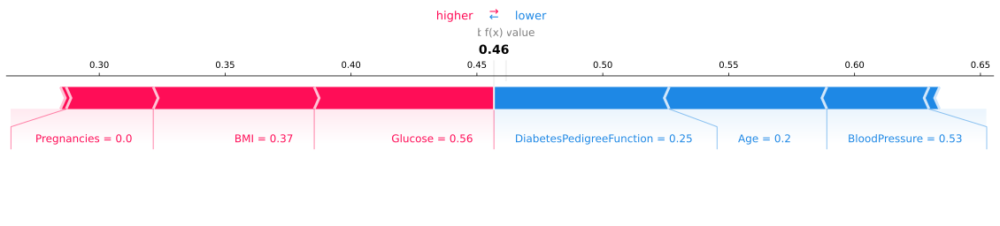

Time taken to provide explanation 3.65 seconds

--------------------------------------------------------------------------------------------

INDEX = 22


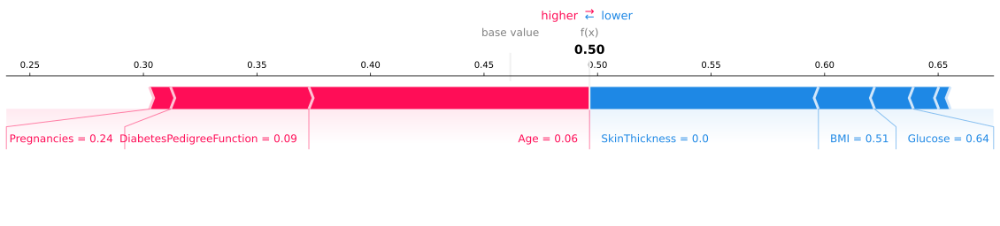

Time taken to provide explanation 3.93 seconds

--------------------------------------------------------------------------------------------

INDEX = 23


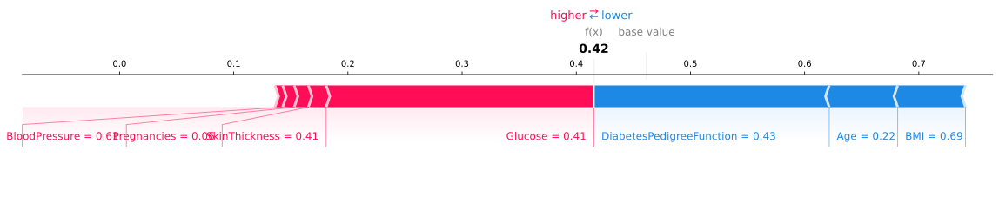

Time taken to provide explanation 3.88 seconds

--------------------------------------------------------------------------------------------

INDEX = 30


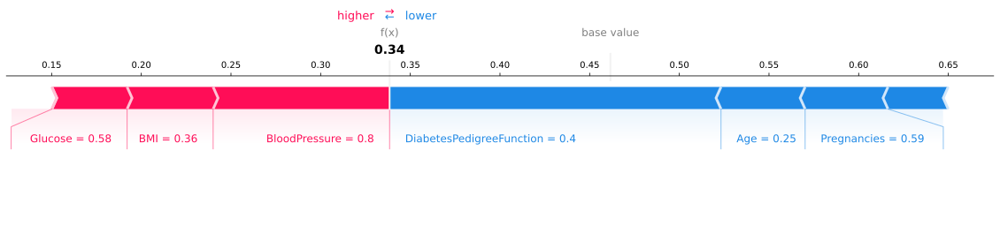

Time taken to provide explanation 3.95 seconds

--------------------------------------------------------------------------------------------

INDEX = 33


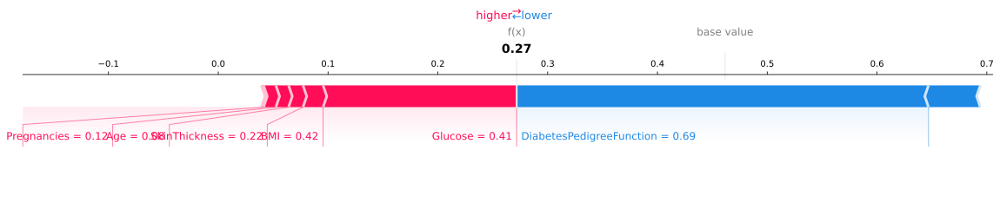

Time taken to provide explanation 3.76 seconds

--------------------------------------------------------------------------------------------

INDEX = 34


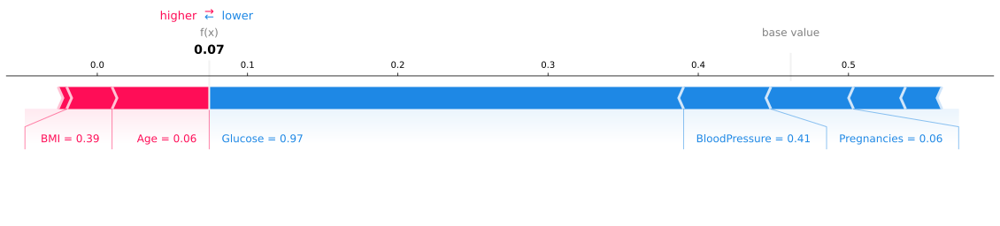

Time taken to provide explanation 3.52 seconds

--------------------------------------------------------------------------------------------

INDEX = 36


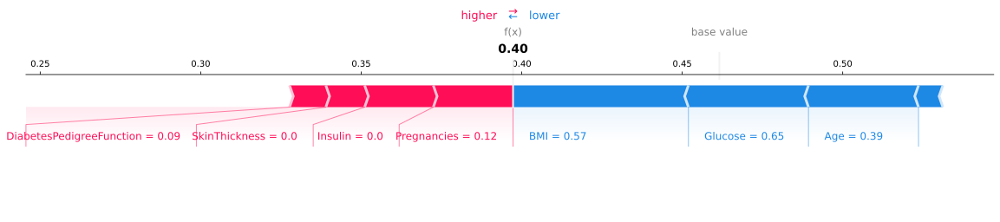

Time taken to provide explanation 3.8 seconds

--------------------------------------------------------------------------------------------

INDEX = 49


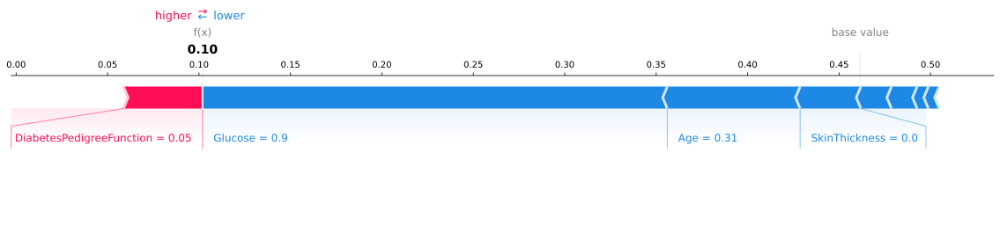

Time taken to provide explanation 3.61 seconds

--------------------------------------------------------------------------------------------

INDEX = 51


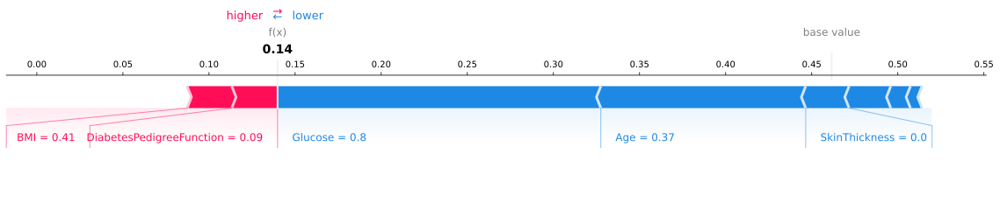

Time taken to provide explanation 3.69 seconds

--------------------------------------------------------------------------------------------

INDEX = 60


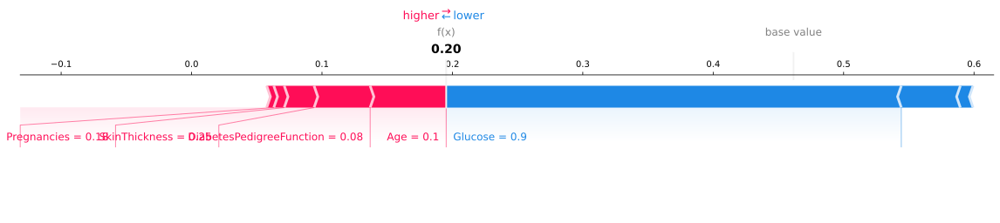

Time taken to provide explanation 3.74 seconds

--------------------------------------------------------------------------------------------

INDEX = 73


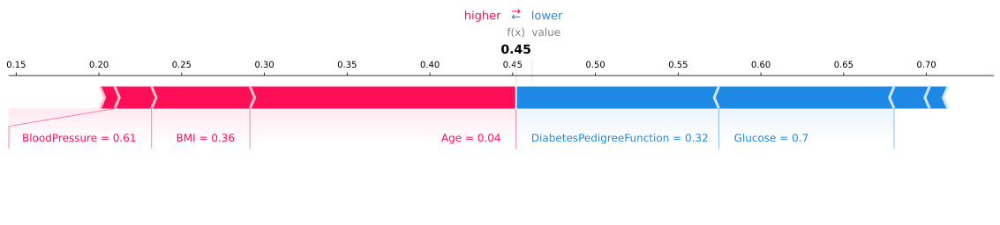

Time taken to provide explanation 3.65 seconds

--------------------------------------------------------------------------------------------



In [133]:
for instance in false_positives:

    print("INDEX = %d" %instance['index'])
    patients_feat = pd.DataFrame(data = [instance['scaled_vector']], columns = feature_names)

    start_time = time.time()
    
    # explain instance
    shap_values = shap_explainer.shap_values(patients_feat)
    exp1 = shap.force_plot(shap_explainer.expected_value[0], shap_values[0], np.around(patients_feat, decimals=2), matplotlib = True, show = True)

    elapsed = time.time() - start_time
    print("Time taken to provide explanation", round (elapsed, 2), "seconds")
    
    print("\n--------------------------------------------------------------------------------------------\n")



INDEX = 4


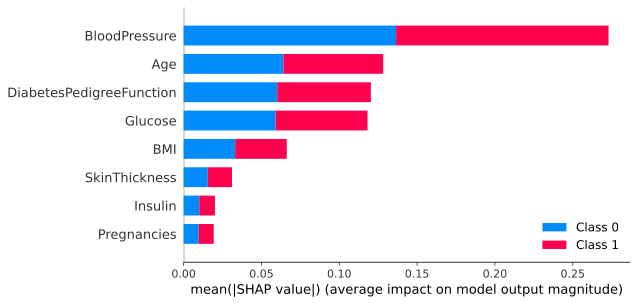

Time taken to provide explanation 3.22 seconds

--------------------------------------------------------------------------------------------

INDEX = 6


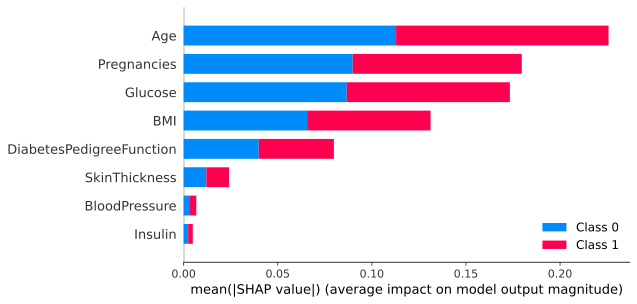

Time taken to provide explanation 3.25 seconds

--------------------------------------------------------------------------------------------

INDEX = 11


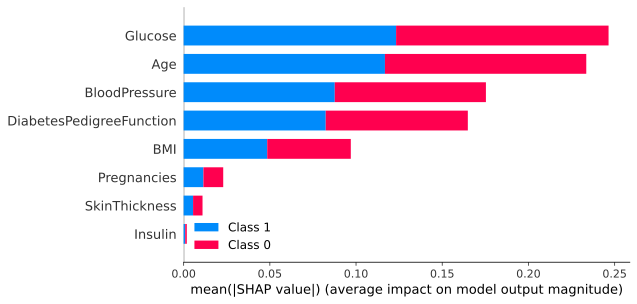

Time taken to provide explanation 3.25 seconds

--------------------------------------------------------------------------------------------

INDEX = 21


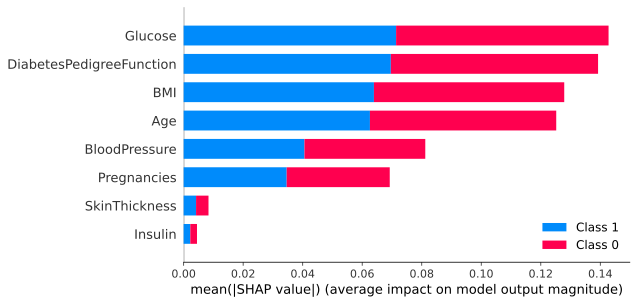

Time taken to provide explanation 3.22 seconds

--------------------------------------------------------------------------------------------

INDEX = 22


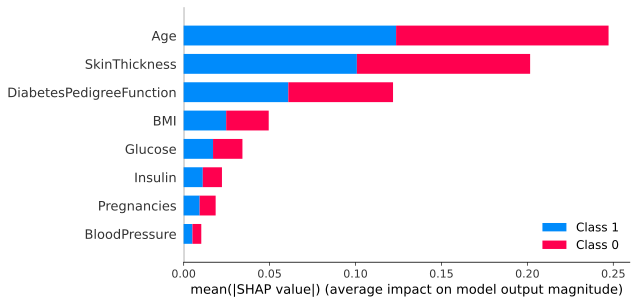

Time taken to provide explanation 3.24 seconds

--------------------------------------------------------------------------------------------

INDEX = 23


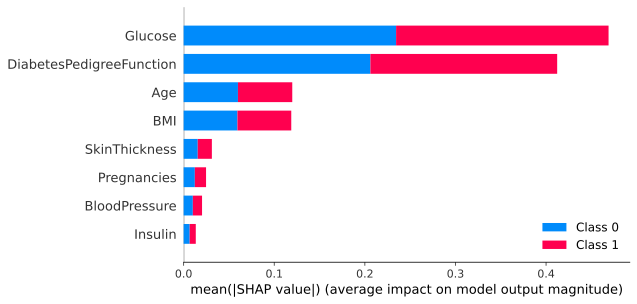

Time taken to provide explanation 3.25 seconds

--------------------------------------------------------------------------------------------

INDEX = 30


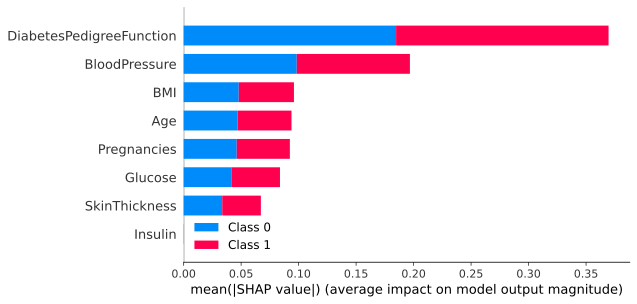

Time taken to provide explanation 3.25 seconds

--------------------------------------------------------------------------------------------

INDEX = 33


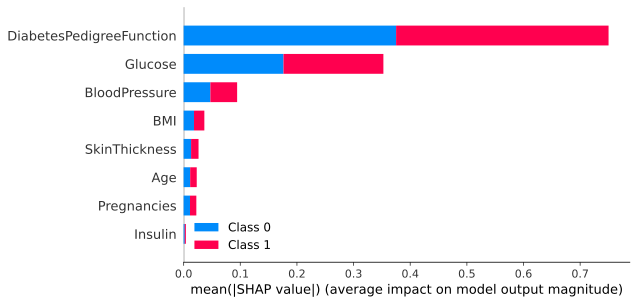

Time taken to provide explanation 3.28 seconds

--------------------------------------------------------------------------------------------

INDEX = 34


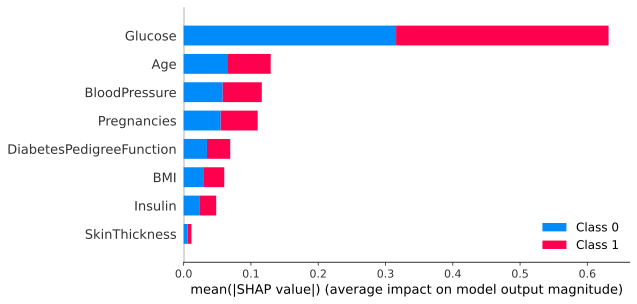

Time taken to provide explanation 3.25 seconds

--------------------------------------------------------------------------------------------

INDEX = 36


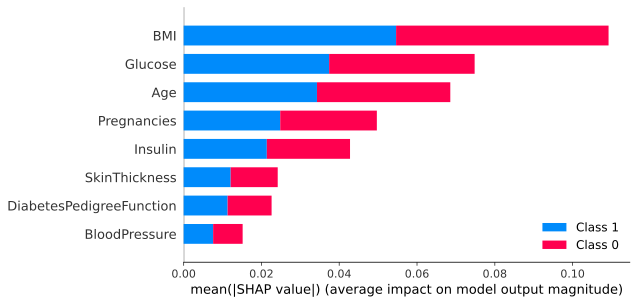

Time taken to provide explanation 3.44 seconds

--------------------------------------------------------------------------------------------

INDEX = 49


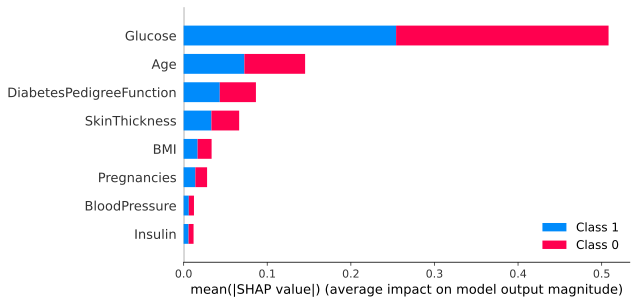

Time taken to provide explanation 3.25 seconds

--------------------------------------------------------------------------------------------

INDEX = 51


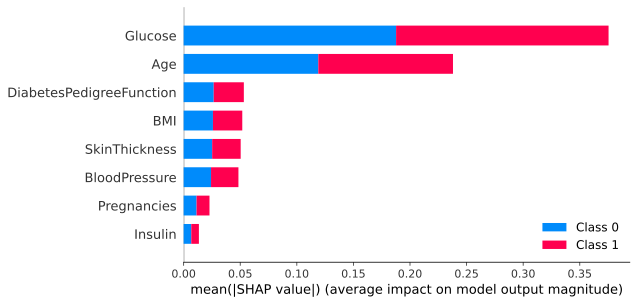

Time taken to provide explanation 3.22 seconds

--------------------------------------------------------------------------------------------

INDEX = 60


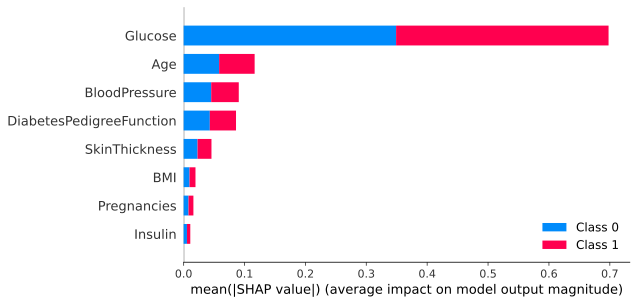

Time taken to provide explanation 3.29 seconds

--------------------------------------------------------------------------------------------

INDEX = 73


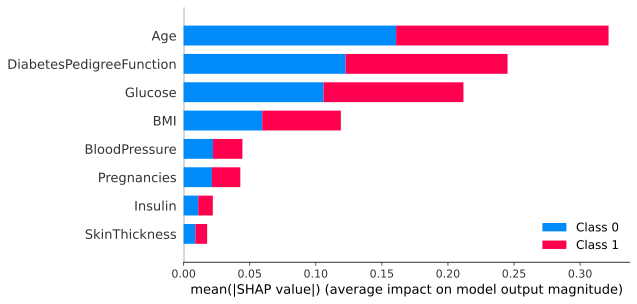

Time taken to provide explanation 3.26 seconds

--------------------------------------------------------------------------------------------



In [134]:
for instance in false_positives:

    print("INDEX = %d" %instance['index'])
    patients_feat = pd.DataFrame(data = [instance['scaled_vector']], columns = feature_names)

    start_time = time.time()
    
    # explain instance
    shap_values = shap_explainer.shap_values(patients_feat)
    exp2 = shap.summary_plot(shap_values, np.around(patients_feat, decimals=2), feature_names=feature_names, max_display=8)

    elapsed = time.time() - start_time
    print("Time taken to provide explanation", round (elapsed, 2), "seconds")
    
    print("\n--------------------------------------------------------------------------------------------\n")



### False Negatives

INDEX = 5


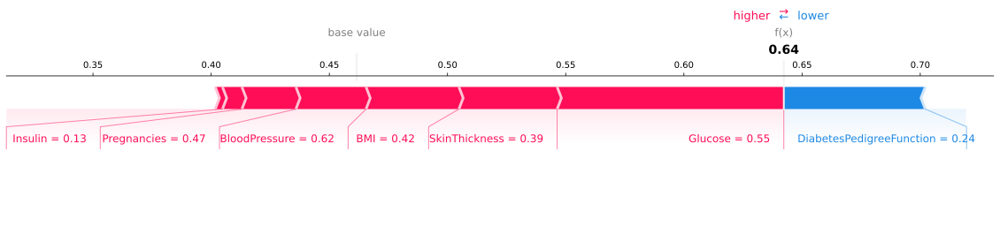

Time taken to provide explanation 3.73 seconds

--------------------------------------------------------------------------------------------

INDEX = 15


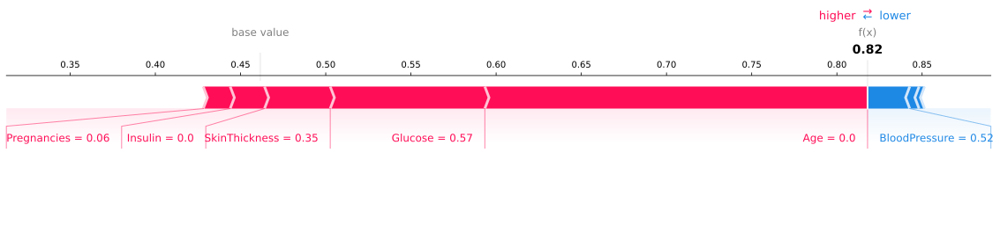

Time taken to provide explanation 3.76 seconds

--------------------------------------------------------------------------------------------

INDEX = 24


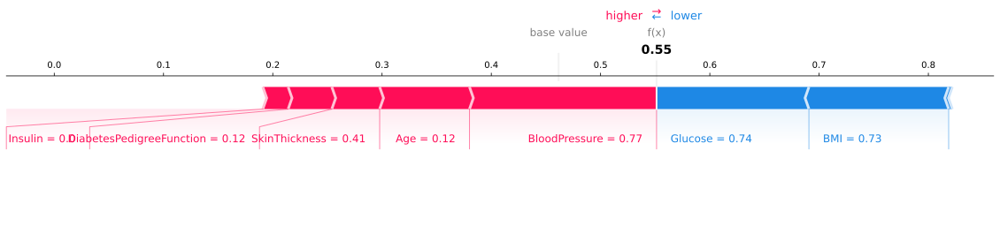

Time taken to provide explanation 3.8 seconds

--------------------------------------------------------------------------------------------

INDEX = 29


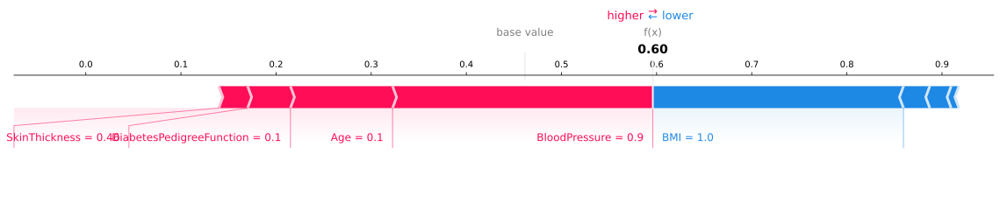

Time taken to provide explanation 3.65 seconds

--------------------------------------------------------------------------------------------

INDEX = 70


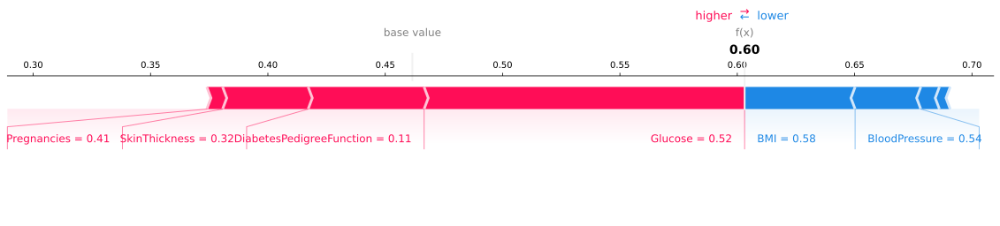

Time taken to provide explanation 3.67 seconds

--------------------------------------------------------------------------------------------

INDEX = 75


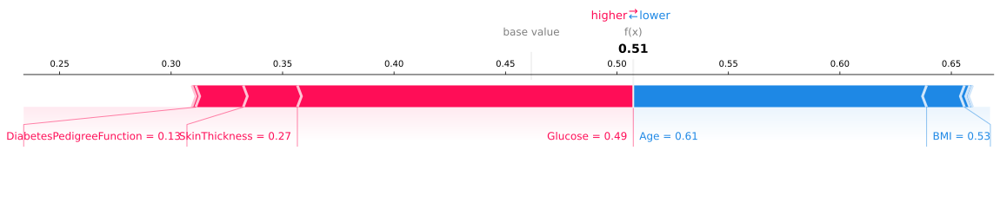

Time taken to provide explanation 3.65 seconds

--------------------------------------------------------------------------------------------

INDEX = 76


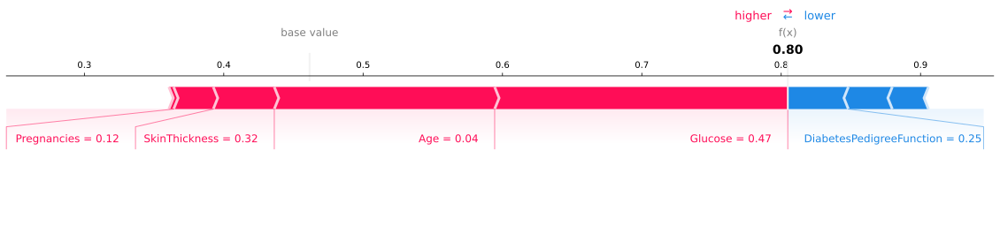

Time taken to provide explanation 3.67 seconds

--------------------------------------------------------------------------------------------



In [135]:
for instance in false_negatives:

    print("INDEX = %d" %instance['index'])
    patients_feat = pd.DataFrame(data = [instance['scaled_vector']], columns = feature_names)

    start_time = time.time()
    
    # explain instance
    shap_values = shap_explainer.shap_values(patients_feat)
    exp1 = shap.force_plot(shap_explainer.expected_value[0], shap_values[0], np.around(patients_feat, decimals=2), matplotlib = True, show = True)

    elapsed = time.time() - start_time
    print("Time taken to provide explanation", round (elapsed, 2), "seconds")
    
    print("\n--------------------------------------------------------------------------------------------\n")




INDEX = 5


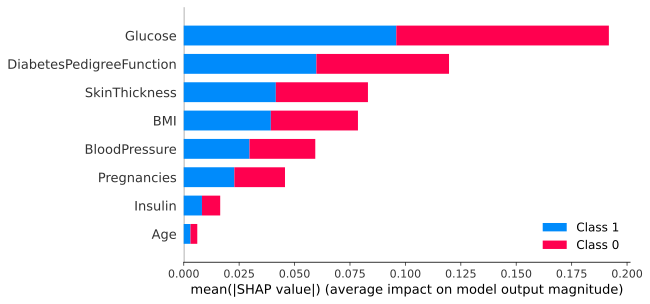

Time taken to provide explanation 3.19 seconds

--------------------------------------------------------------------------------------------

INDEX = 15


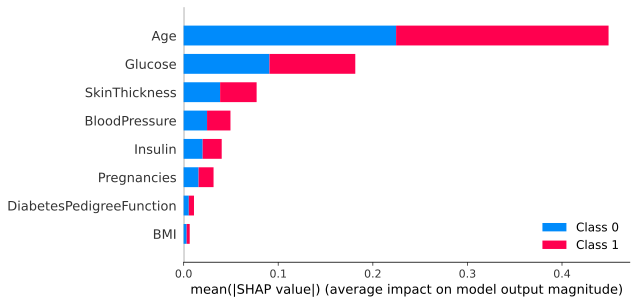

Time taken to provide explanation 3.29 seconds

--------------------------------------------------------------------------------------------

INDEX = 24


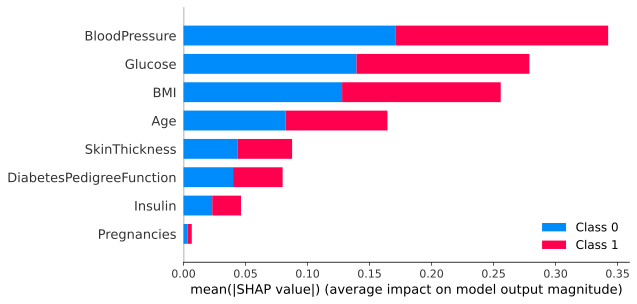

Time taken to provide explanation 3.21 seconds

--------------------------------------------------------------------------------------------

INDEX = 29


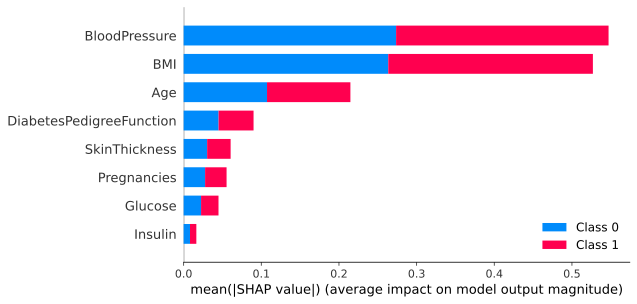

Time taken to provide explanation 3.14 seconds

--------------------------------------------------------------------------------------------

INDEX = 70


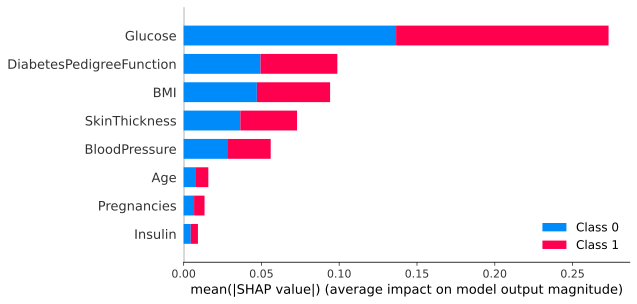

Time taken to provide explanation 3.15 seconds

--------------------------------------------------------------------------------------------

INDEX = 75


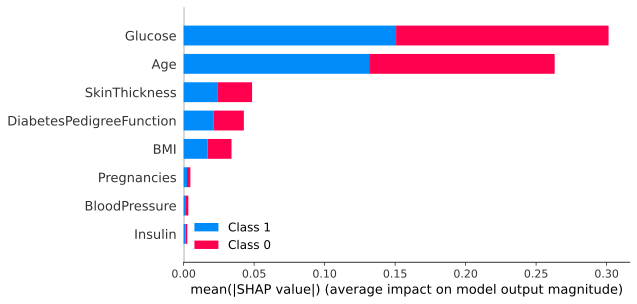

Time taken to provide explanation 3.14 seconds

--------------------------------------------------------------------------------------------

INDEX = 76


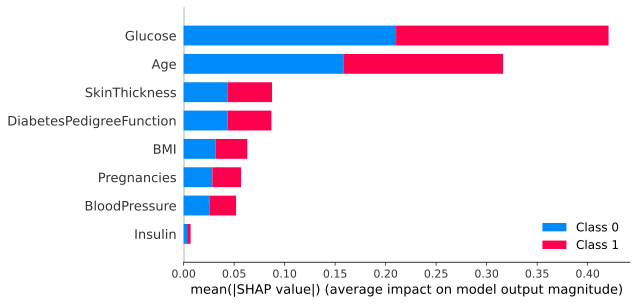

Time taken to provide explanation 3.27 seconds

--------------------------------------------------------------------------------------------



In [136]:
for instance in false_negatives:

    print("INDEX = %d" %instance['index'])
    patients_feat = pd.DataFrame(data = [instance['scaled_vector']], columns = feature_names)

    start_time = time.time()
    
    # explain instance
    shap_values = shap_explainer.shap_values(patients_feat)
    exp2 = shap.summary_plot(shap_values, np.around(patients_feat, decimals=2), feature_names=feature_names, max_display=8)

    elapsed = time.time() - start_time
    print("Time taken to provide explanation", round (elapsed, 2), "seconds")
    
    print("\n--------------------------------------------------------------------------------------------\n")


### True Negatives

INDEX = 2


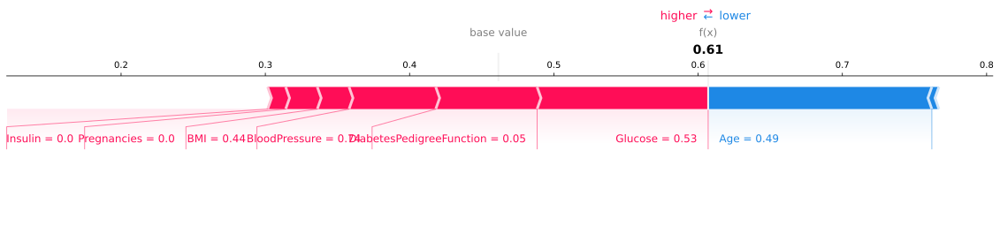

Time taken to provide explanation 3.73 seconds

--------------------------------------------------------------------------------------------

INDEX = 8


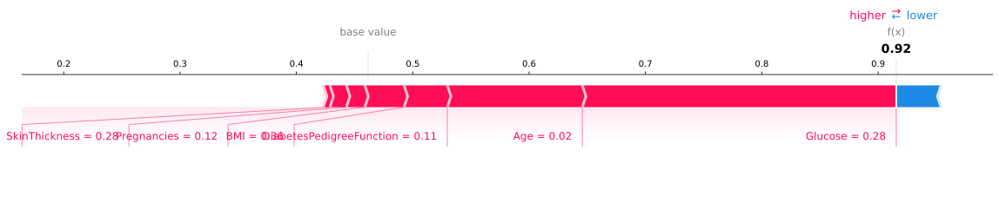

Time taken to provide explanation 3.64 seconds

--------------------------------------------------------------------------------------------

INDEX = 9


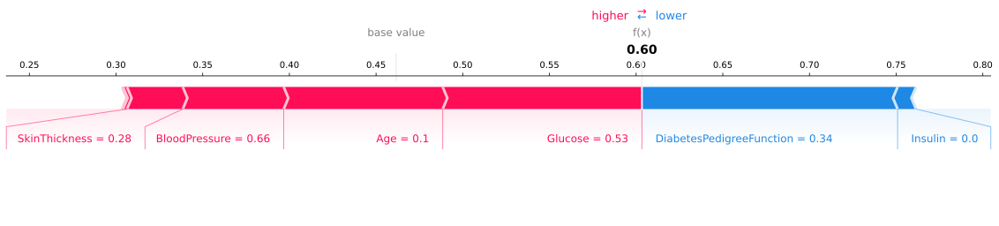

Time taken to provide explanation 3.94 seconds

--------------------------------------------------------------------------------------------

INDEX = 12


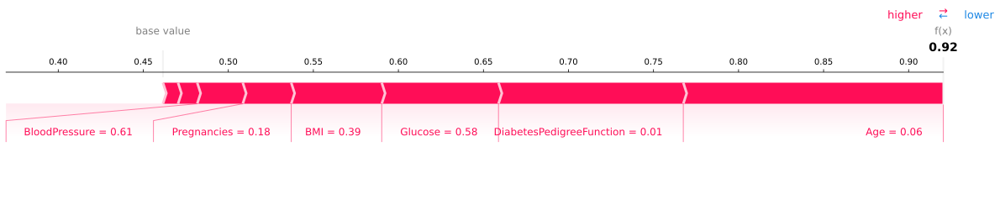

Time taken to provide explanation 3.69 seconds

--------------------------------------------------------------------------------------------

INDEX = 13


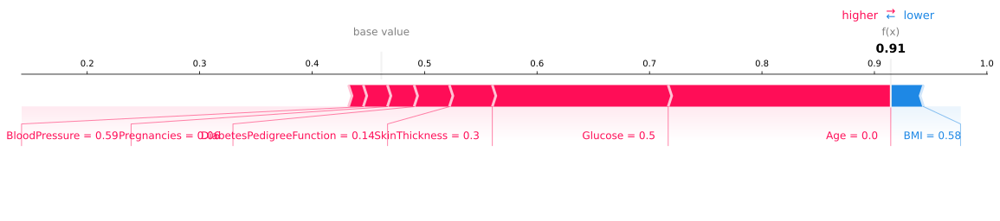

Time taken to provide explanation 3.69 seconds

--------------------------------------------------------------------------------------------

INDEX = 16


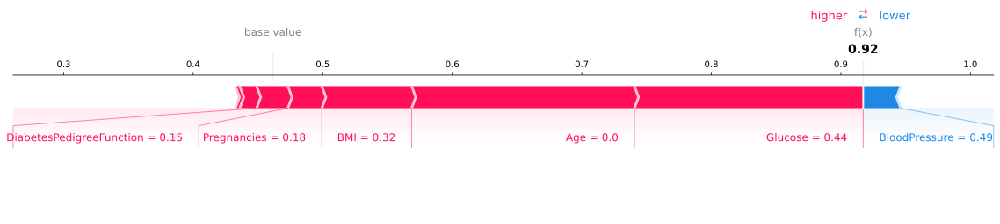

Time taken to provide explanation 3.67 seconds

--------------------------------------------------------------------------------------------

INDEX = 17


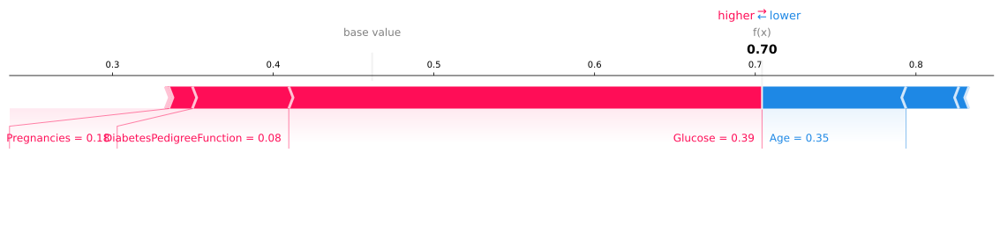

Time taken to provide explanation 3.62 seconds

--------------------------------------------------------------------------------------------

INDEX = 18


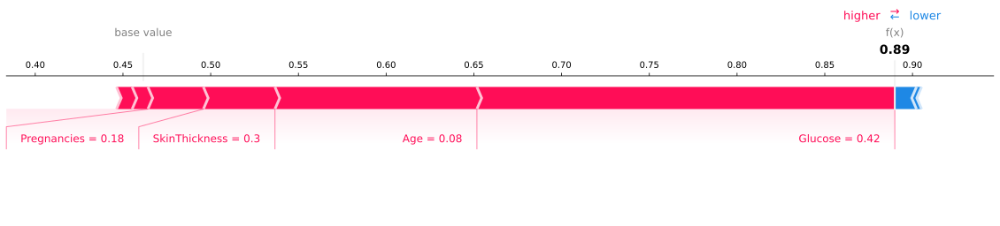

Time taken to provide explanation 3.6 seconds

--------------------------------------------------------------------------------------------

INDEX = 25


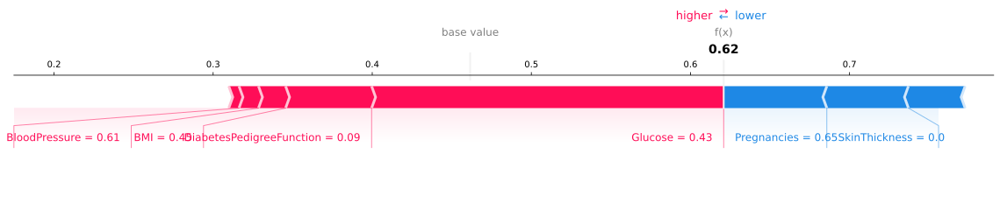

Time taken to provide explanation 3.75 seconds

--------------------------------------------------------------------------------------------

INDEX = 26


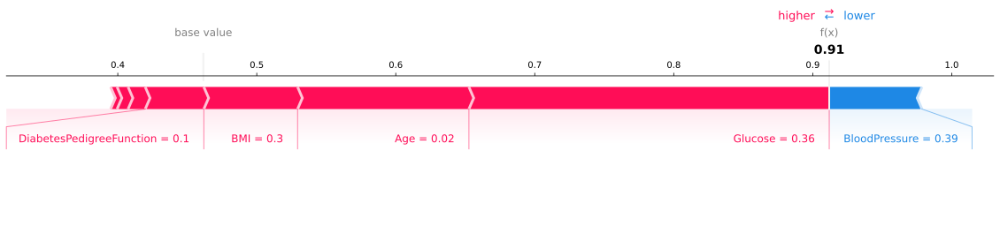

Time taken to provide explanation 3.57 seconds

--------------------------------------------------------------------------------------------

INDEX = 27


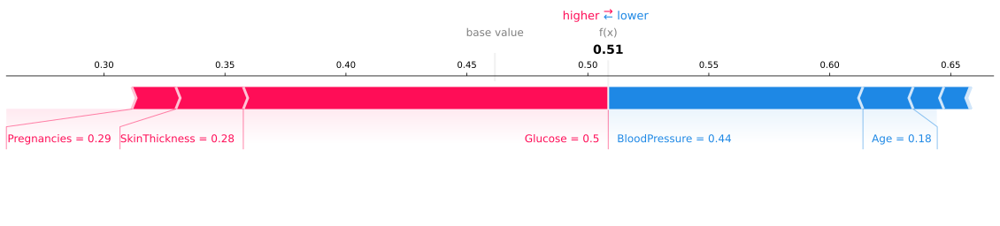

Time taken to provide explanation 3.66 seconds

--------------------------------------------------------------------------------------------

INDEX = 28


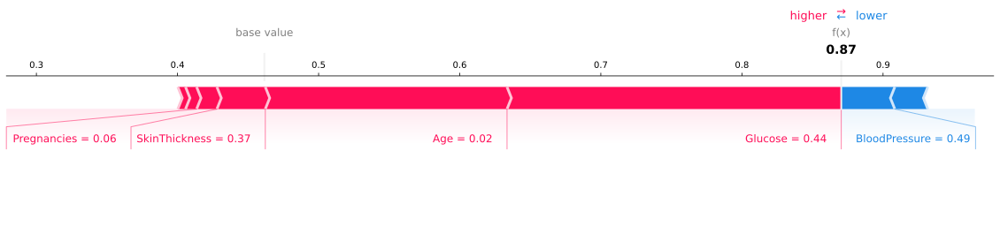

Time taken to provide explanation 3.61 seconds

--------------------------------------------------------------------------------------------

INDEX = 38


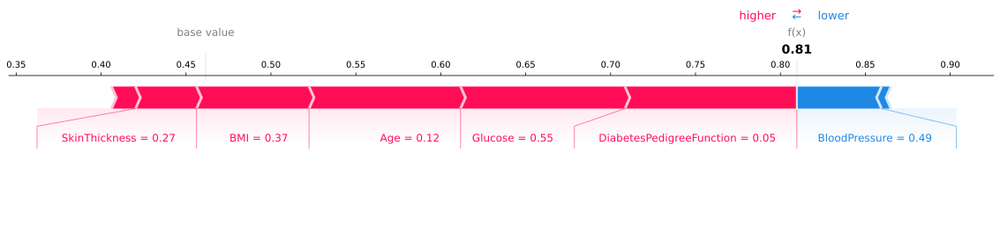

Time taken to provide explanation 3.79 seconds

--------------------------------------------------------------------------------------------

INDEX = 40


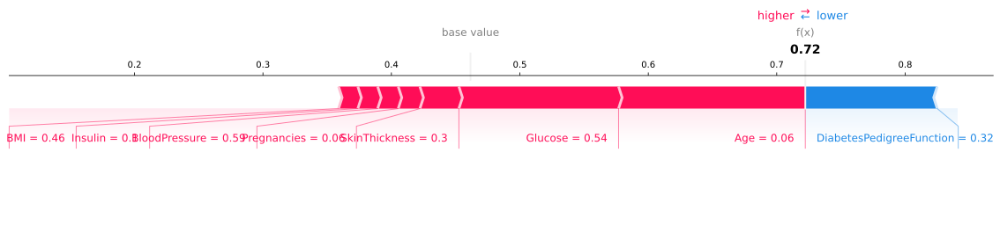

Time taken to provide explanation 3.77 seconds

--------------------------------------------------------------------------------------------

INDEX = 43


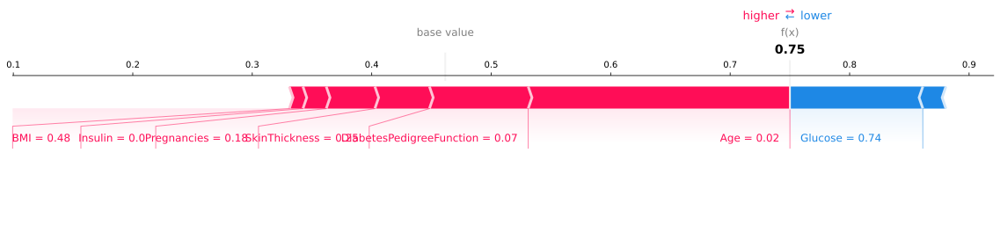

Time taken to provide explanation 3.71 seconds

--------------------------------------------------------------------------------------------

INDEX = 46


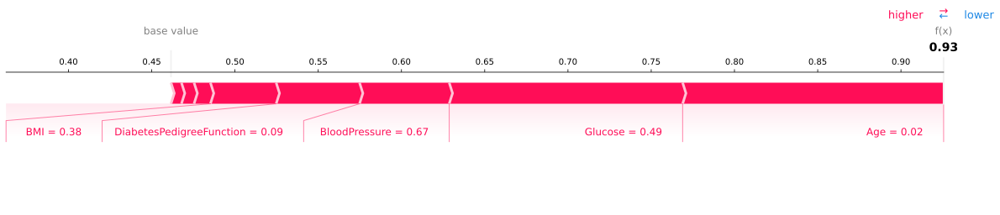

Time taken to provide explanation 3.63 seconds

--------------------------------------------------------------------------------------------

INDEX = 48


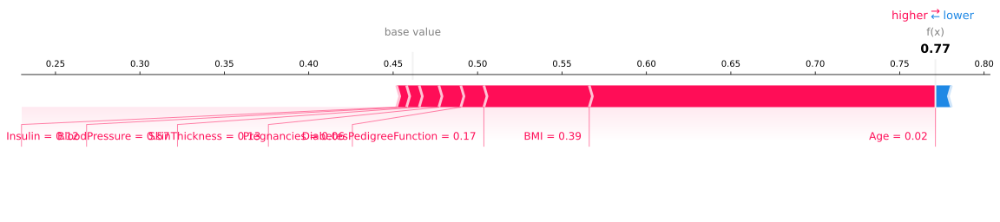

Time taken to provide explanation 3.65 seconds

--------------------------------------------------------------------------------------------

INDEX = 55


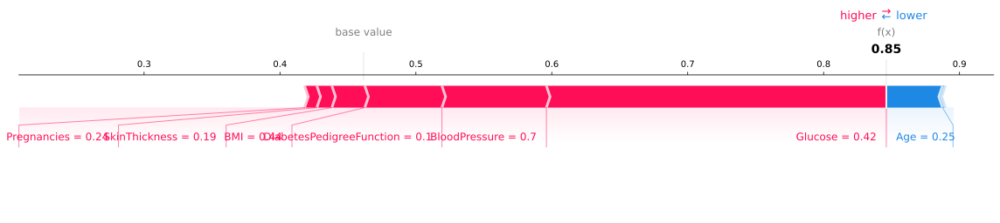

Time taken to provide explanation 3.66 seconds

--------------------------------------------------------------------------------------------

INDEX = 56


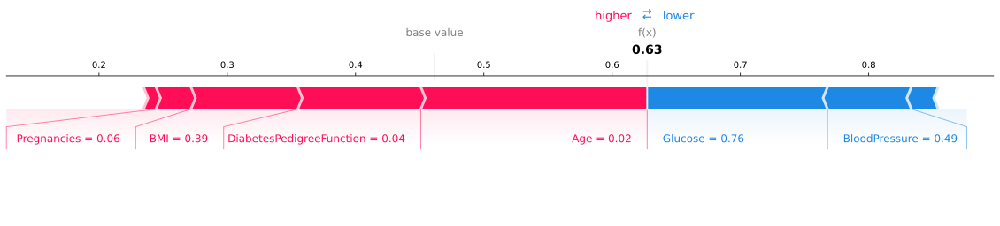

Time taken to provide explanation 3.66 seconds

--------------------------------------------------------------------------------------------

INDEX = 57


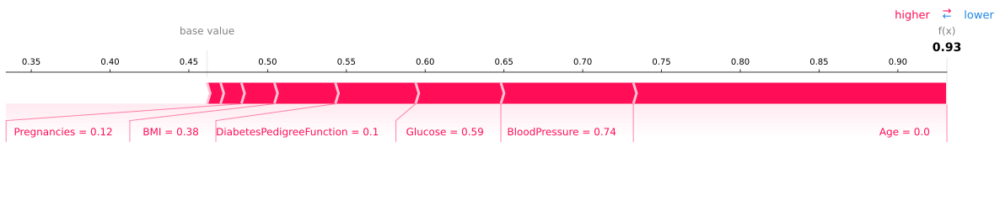

Time taken to provide explanation 3.6 seconds

--------------------------------------------------------------------------------------------

INDEX = 58


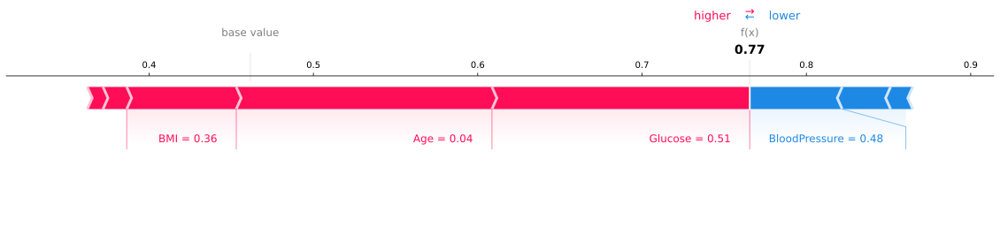

Time taken to provide explanation 3.79 seconds

--------------------------------------------------------------------------------------------

INDEX = 59


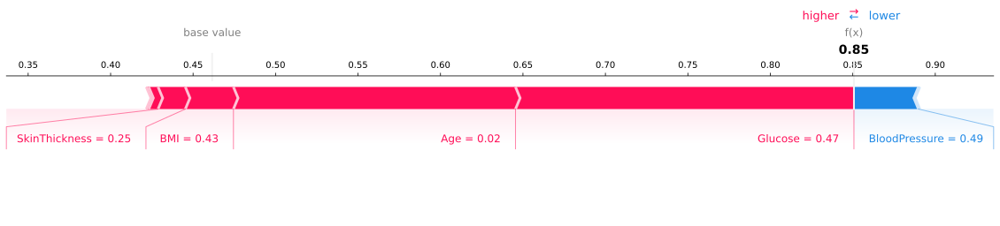

Time taken to provide explanation 3.66 seconds

--------------------------------------------------------------------------------------------

INDEX = 64


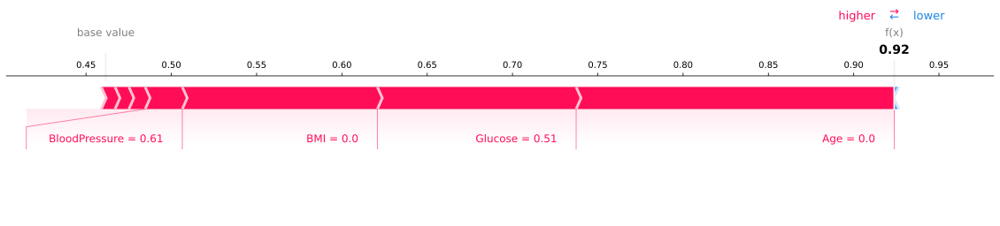

Time taken to provide explanation 3.6 seconds

--------------------------------------------------------------------------------------------

INDEX = 66


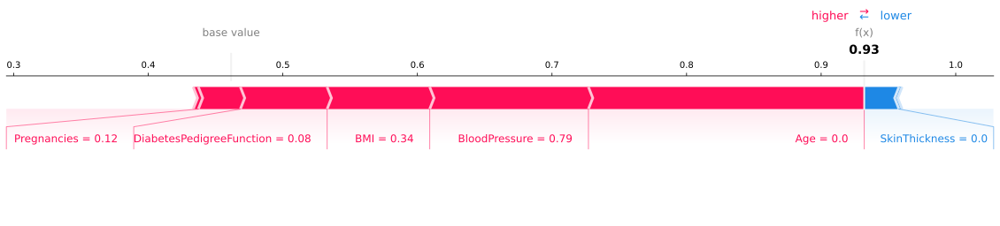

Time taken to provide explanation 3.6 seconds

--------------------------------------------------------------------------------------------

INDEX = 69


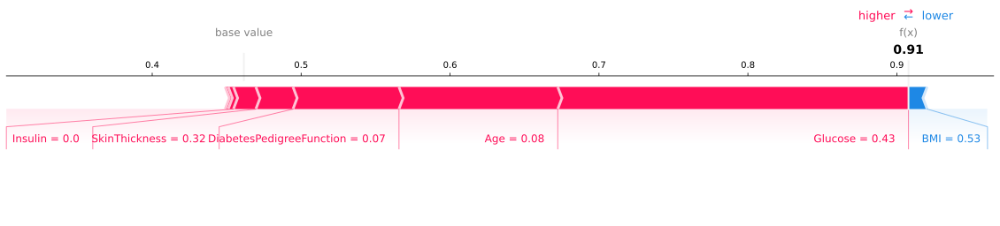

Time taken to provide explanation 3.71 seconds

--------------------------------------------------------------------------------------------

INDEX = 77


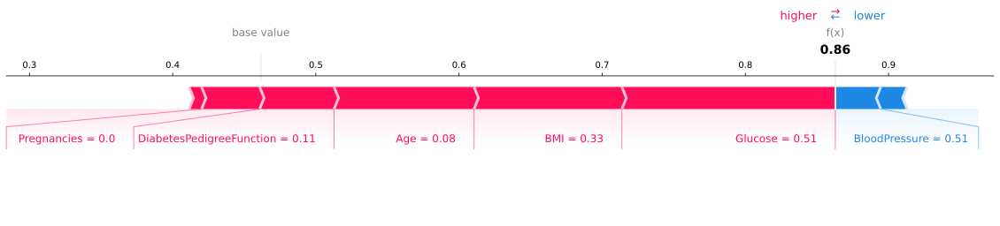

Time taken to provide explanation 3.63 seconds

--------------------------------------------------------------------------------------------



In [137]:
for instance in true_negatives:

    print("INDEX = %d" %instance['index'])
    patients_feat = pd.DataFrame(data = [instance['scaled_vector']], columns = feature_names)

    start_time = time.time()
    
    # explain instance
    shap_values = shap_explainer.shap_values(patients_feat)
    exp1 = shap.force_plot(shap_explainer.expected_value[0], shap_values[0], np.around(patients_feat, decimals=2), matplotlib = True, show = True)

    elapsed = time.time() - start_time
    print("Time taken to provide explanation", round (elapsed, 2), "seconds")
    
    print("\n--------------------------------------------------------------------------------------------\n")


INDEX = 2


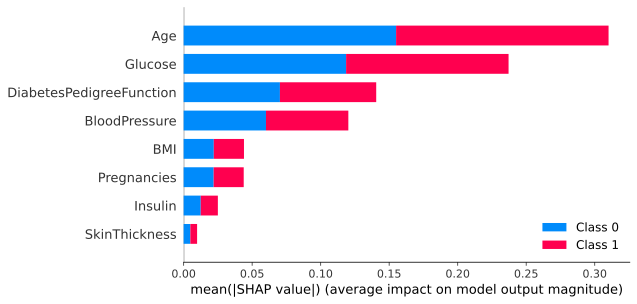

Time taken to provide explanation 3.2 seconds

--------------------------------------------------------------------------------------------

INDEX = 8


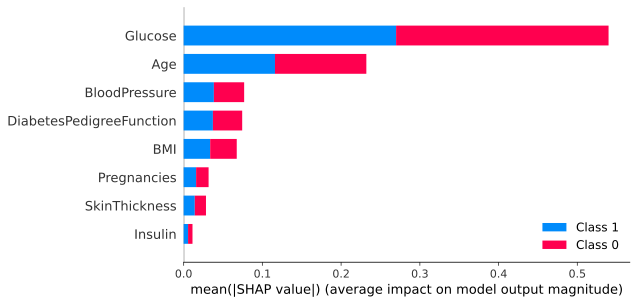

Time taken to provide explanation 3.26 seconds

--------------------------------------------------------------------------------------------

INDEX = 9


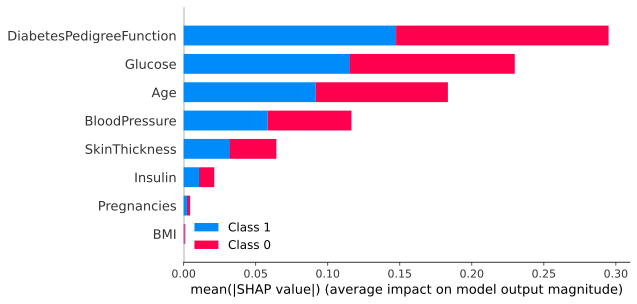

Time taken to provide explanation 3.24 seconds

--------------------------------------------------------------------------------------------

INDEX = 12


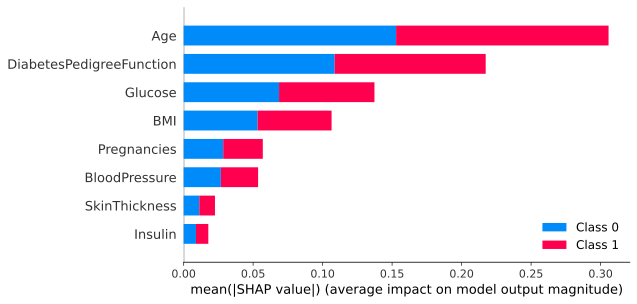

Time taken to provide explanation 3.24 seconds

--------------------------------------------------------------------------------------------

INDEX = 13


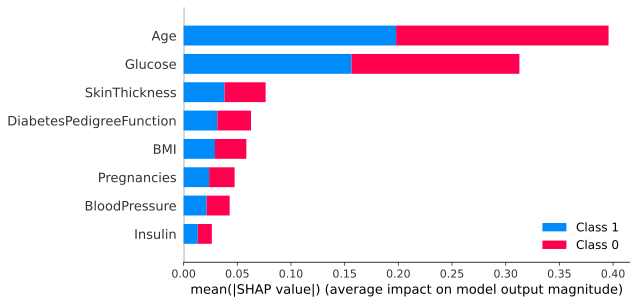

Time taken to provide explanation 3.26 seconds

--------------------------------------------------------------------------------------------

INDEX = 16


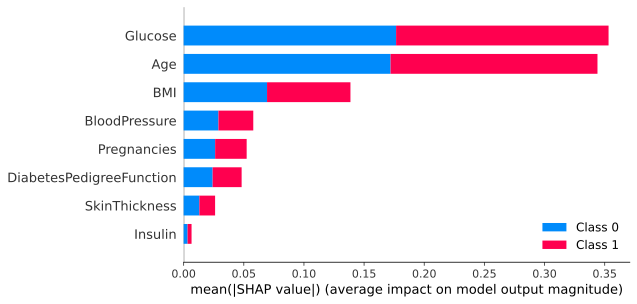

Time taken to provide explanation 3.23 seconds

--------------------------------------------------------------------------------------------

INDEX = 17


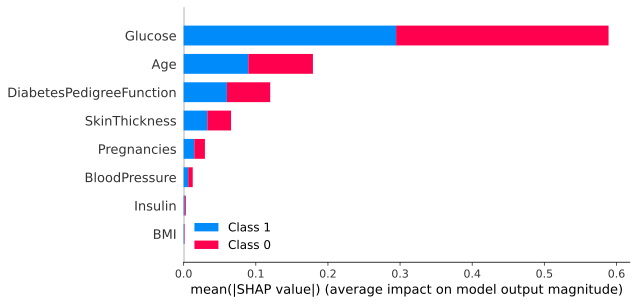

Time taken to provide explanation 3.27 seconds

--------------------------------------------------------------------------------------------

INDEX = 18


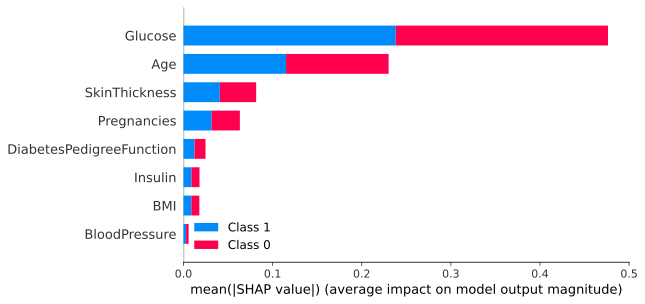

Time taken to provide explanation 3.25 seconds

--------------------------------------------------------------------------------------------

INDEX = 25


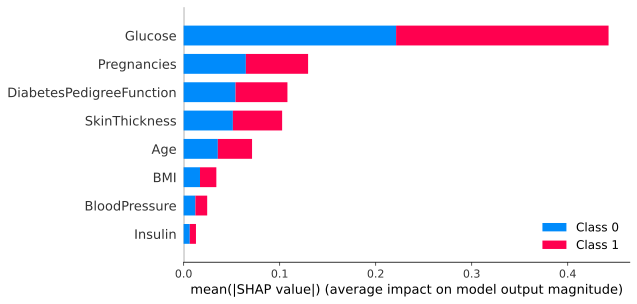

Time taken to provide explanation 3.22 seconds

--------------------------------------------------------------------------------------------

INDEX = 26


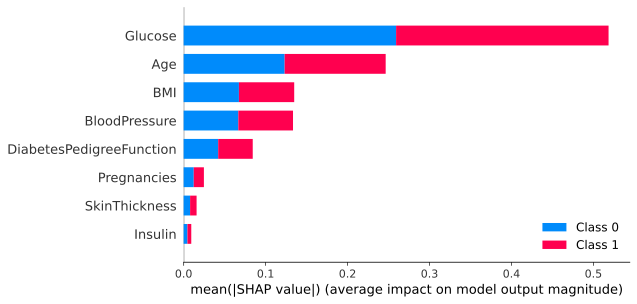

Time taken to provide explanation 3.22 seconds

--------------------------------------------------------------------------------------------

INDEX = 27


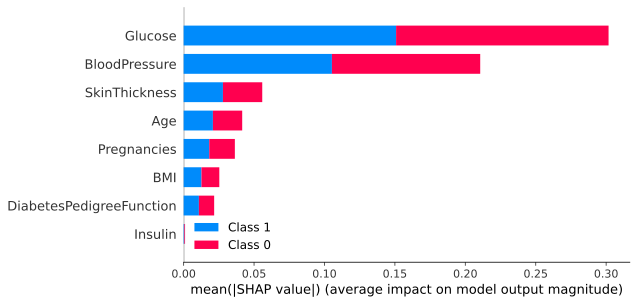

Time taken to provide explanation 3.17 seconds

--------------------------------------------------------------------------------------------

INDEX = 28


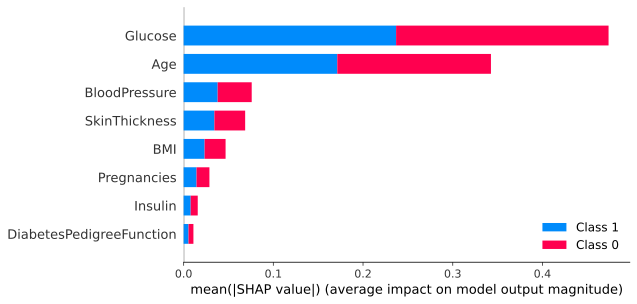

Time taken to provide explanation 3.21 seconds

--------------------------------------------------------------------------------------------

INDEX = 38


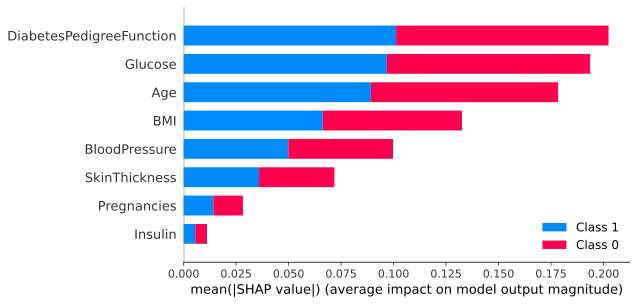

Time taken to provide explanation 3.23 seconds

--------------------------------------------------------------------------------------------

INDEX = 40


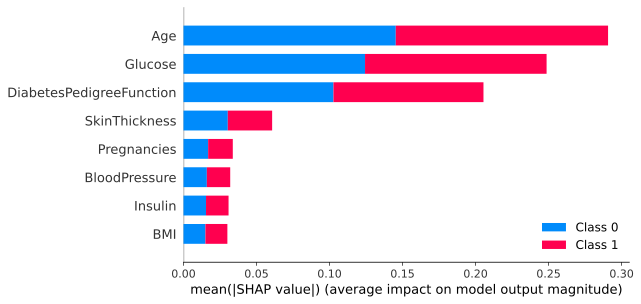

Time taken to provide explanation 3.18 seconds

--------------------------------------------------------------------------------------------

INDEX = 43


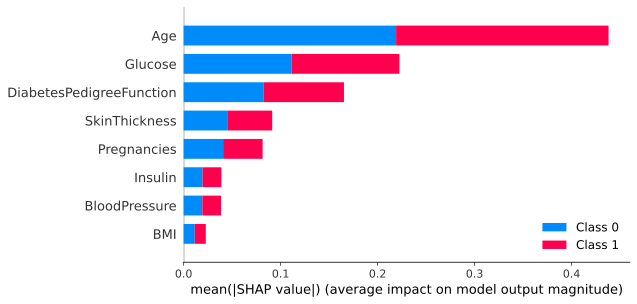

Time taken to provide explanation 3.33 seconds

--------------------------------------------------------------------------------------------

INDEX = 46


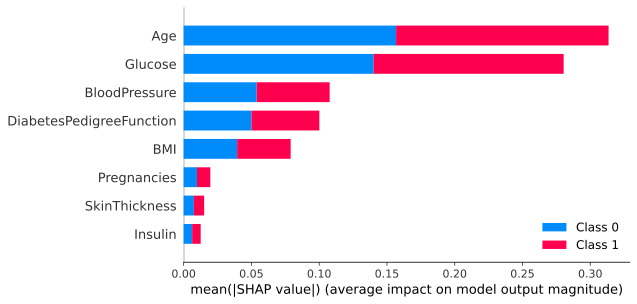

Time taken to provide explanation 3.21 seconds

--------------------------------------------------------------------------------------------

INDEX = 48


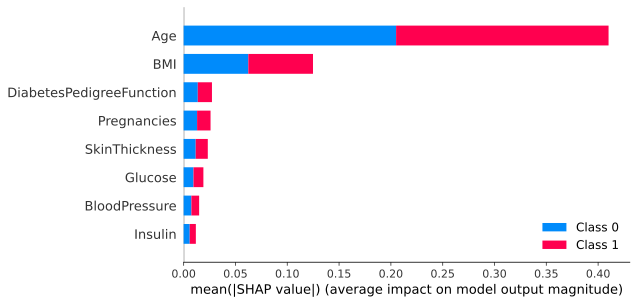

Time taken to provide explanation 3.43 seconds

--------------------------------------------------------------------------------------------

INDEX = 55


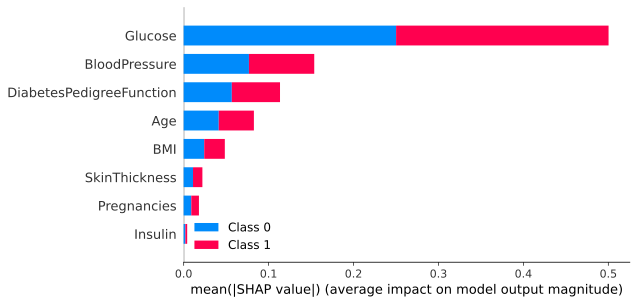

Time taken to provide explanation 3.29 seconds

--------------------------------------------------------------------------------------------

INDEX = 56


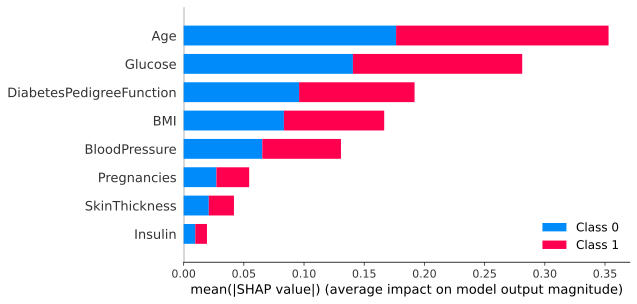

Time taken to provide explanation 3.17 seconds

--------------------------------------------------------------------------------------------

INDEX = 57


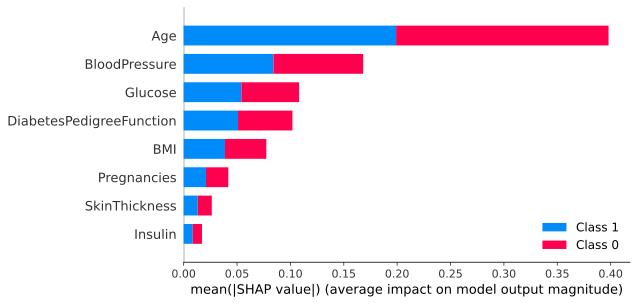

Time taken to provide explanation 3.21 seconds

--------------------------------------------------------------------------------------------

INDEX = 58


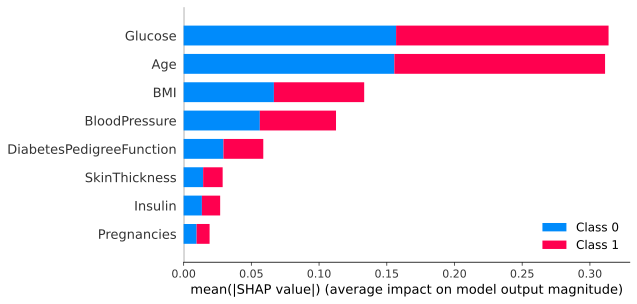

Time taken to provide explanation 3.14 seconds

--------------------------------------------------------------------------------------------

INDEX = 59


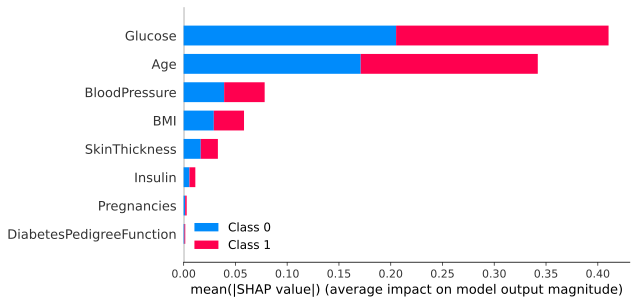

Time taken to provide explanation 3.17 seconds

--------------------------------------------------------------------------------------------

INDEX = 64


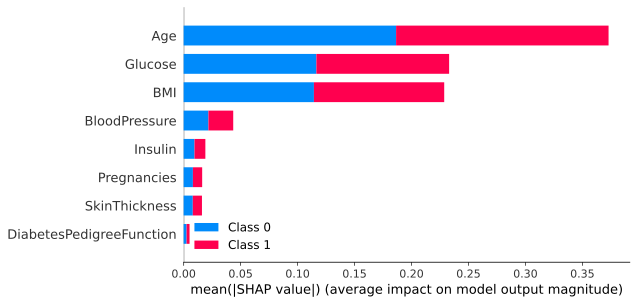

Time taken to provide explanation 3.19 seconds

--------------------------------------------------------------------------------------------

INDEX = 66


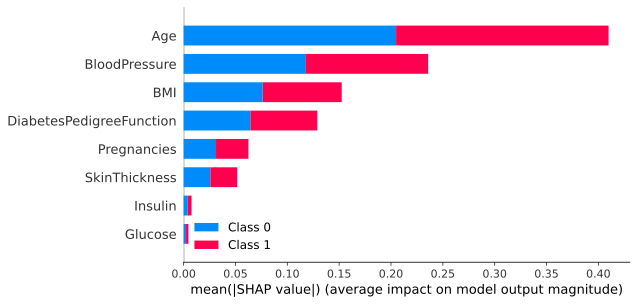

Time taken to provide explanation 3.19 seconds

--------------------------------------------------------------------------------------------

INDEX = 69


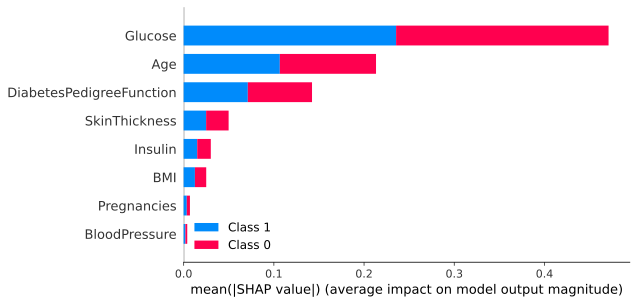

Time taken to provide explanation 3.25 seconds

--------------------------------------------------------------------------------------------

INDEX = 77


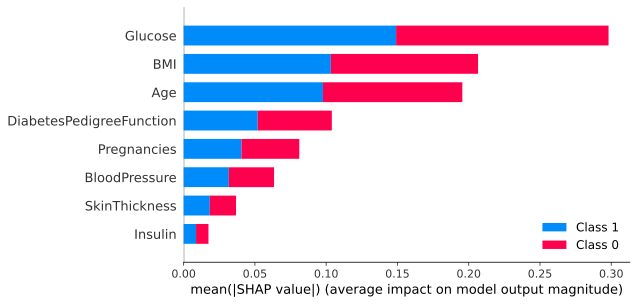

Time taken to provide explanation 3.24 seconds

--------------------------------------------------------------------------------------------



In [138]:
for instance in true_negatives:

    print("INDEX = %d" %instance['index'])
    patients_feat = pd.DataFrame(data = [instance['scaled_vector']], columns = feature_names)

    start_time = time.time()
    
    # explain instance
    shap_values = shap_explainer.shap_values(patients_feat)
    exp2 = shap.summary_plot(shap_values, np.around(patients_feat, decimals=2), feature_names=feature_names, max_display=8)

    elapsed = time.time() - start_time
    print("Time taken to provide explanation", round (elapsed, 2), "seconds")
    
    print("\n--------------------------------------------------------------------------------------------\n")
